In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Epoch 1/20
1/1 [==============================] - 0s 64ms/step


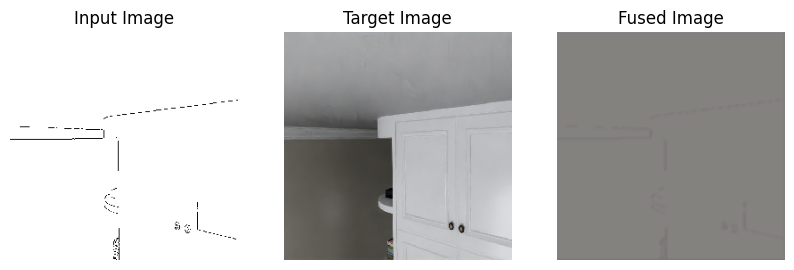

1/1 [==============================] - 0s 21ms/step


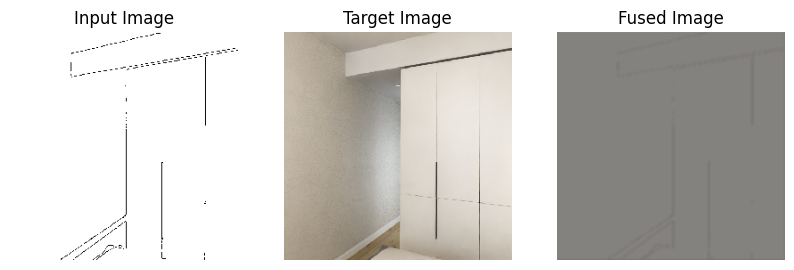

1/1 [==============================] - 0s 21ms/step


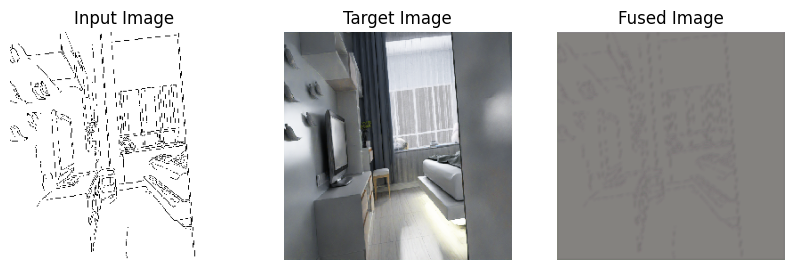

1/1 [==============================] - 0s 21ms/step


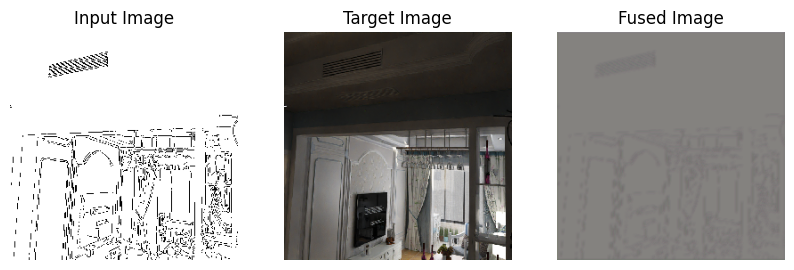

1/1 [==============================] - 0s 21ms/step


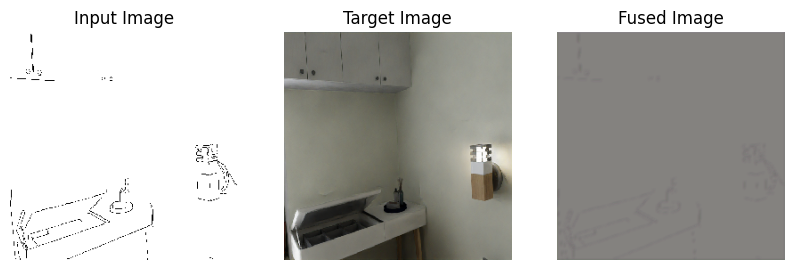

Epoch 2/20
1/1 [==============================] - 0s 21ms/step


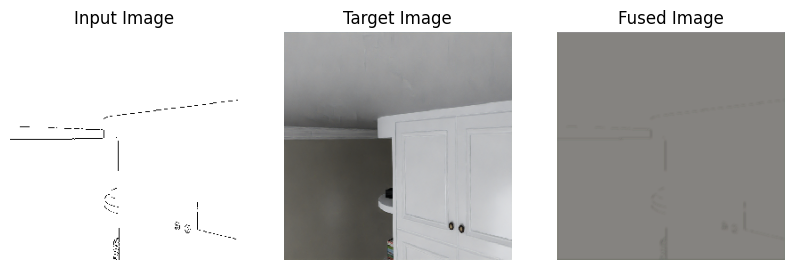

1/1 [==============================] - 0s 21ms/step


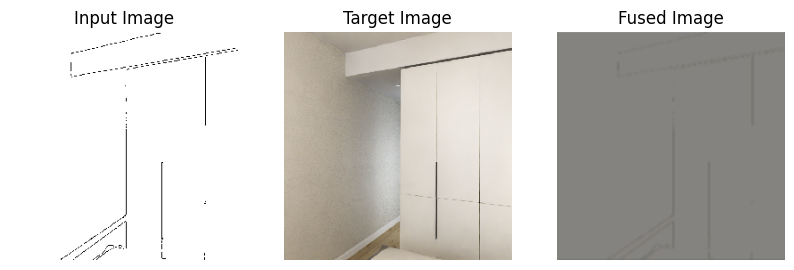

1/1 [==============================] - 0s 21ms/step


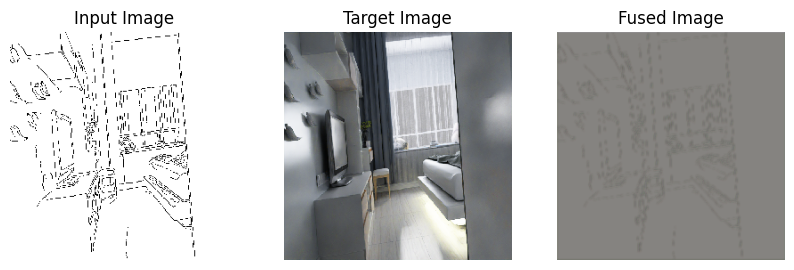

1/1 [==============================] - 0s 21ms/step


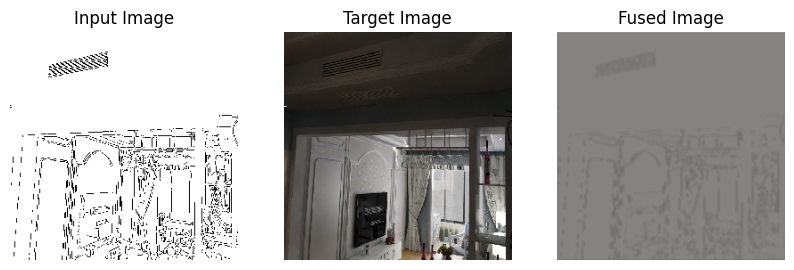

1/1 [==============================] - 0s 21ms/step


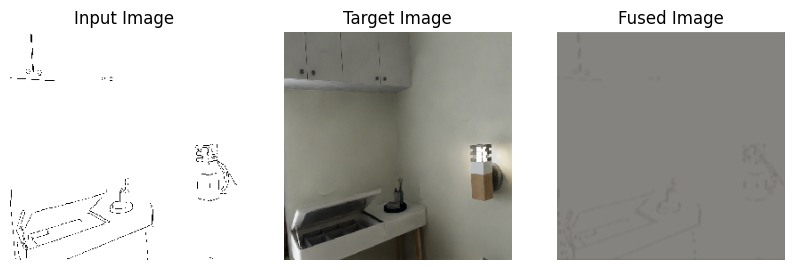

Epoch 3/20
1/1 [==============================] - 0s 22ms/step


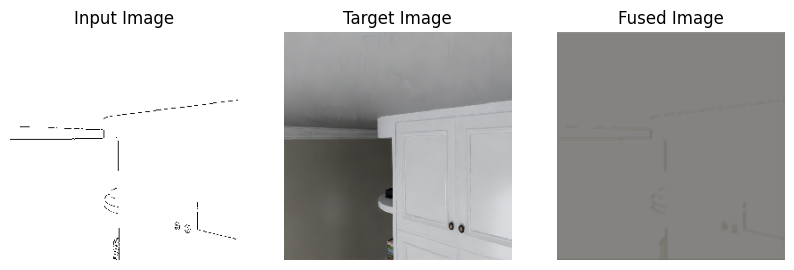

1/1 [==============================] - 0s 22ms/step


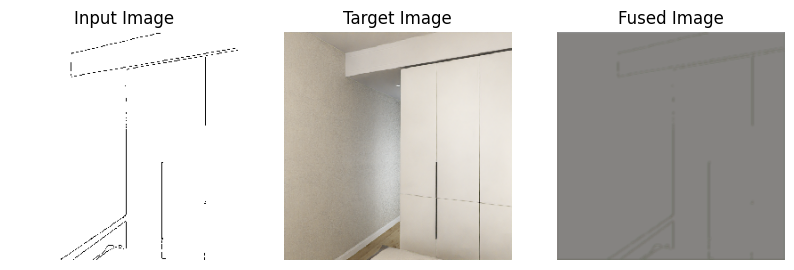

1/1 [==============================] - 0s 22ms/step


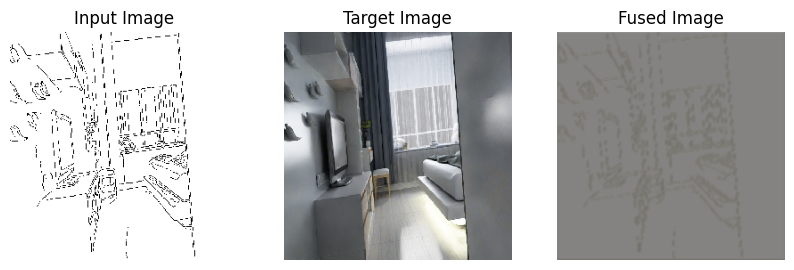

1/1 [==============================] - 0s 22ms/step


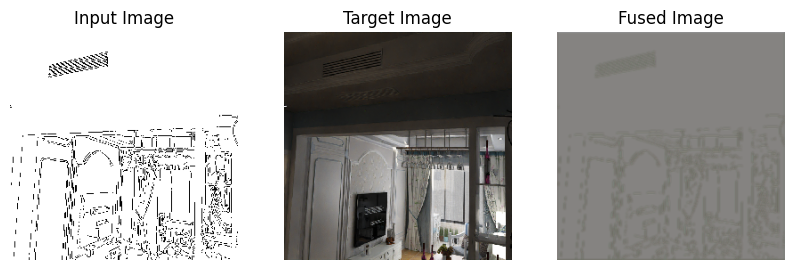

1/1 [==============================] - 0s 22ms/step


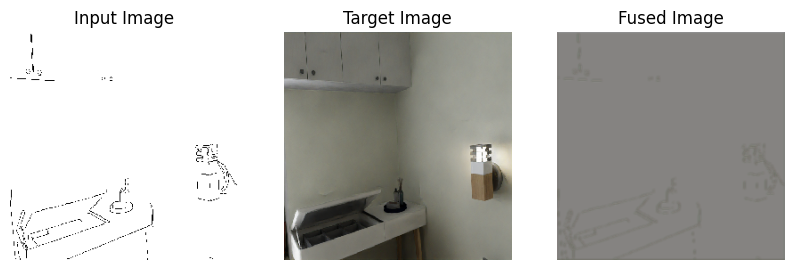

Epoch 4/20
1/1 [==============================] - 0s 23ms/step


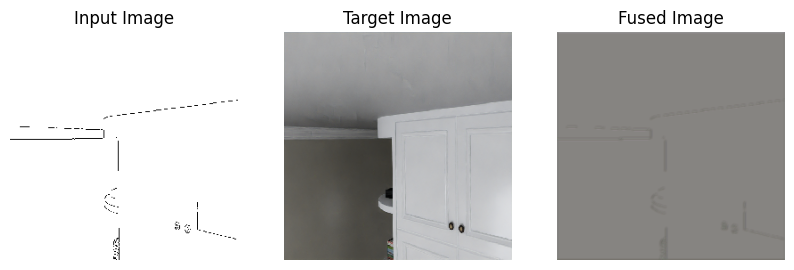

1/1 [==============================] - 0s 22ms/step


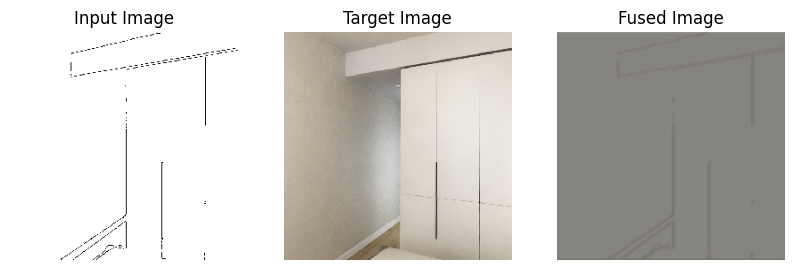

1/1 [==============================] - 0s 22ms/step


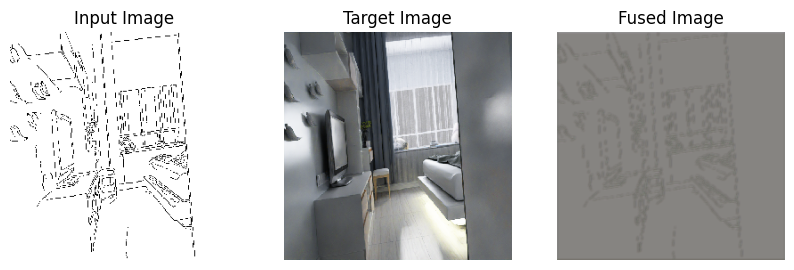

1/1 [==============================] - 0s 22ms/step


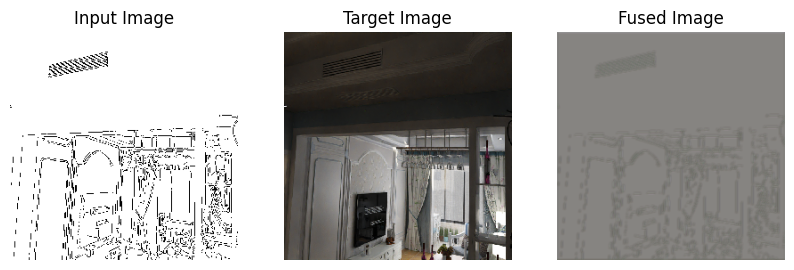

1/1 [==============================] - 0s 23ms/step


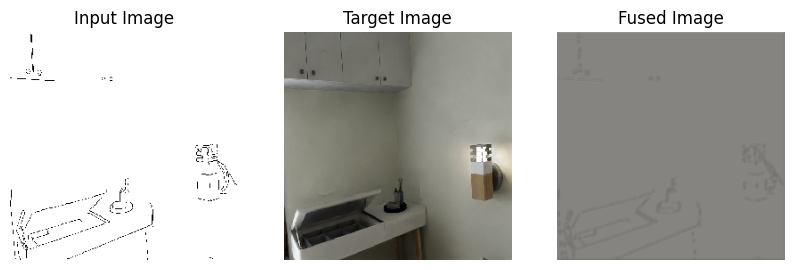

Epoch 5/20
1/1 [==============================] - 0s 22ms/step


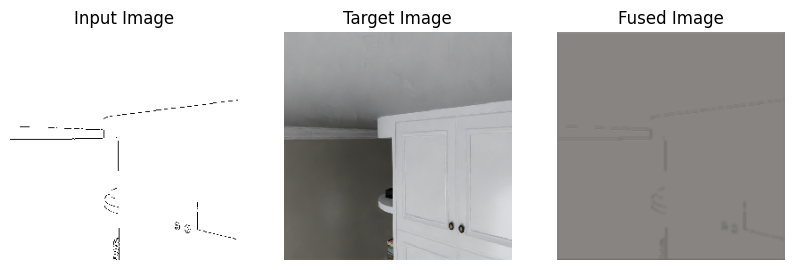

1/1 [==============================] - 0s 22ms/step


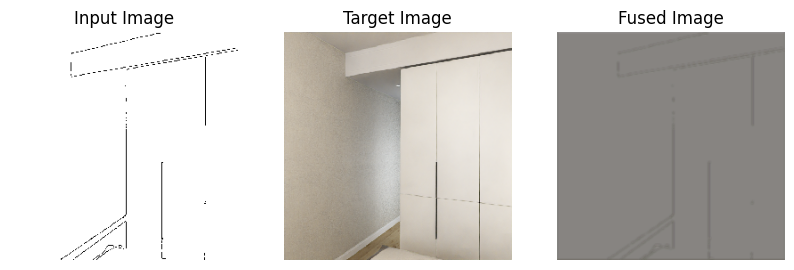

1/1 [==============================] - 0s 21ms/step


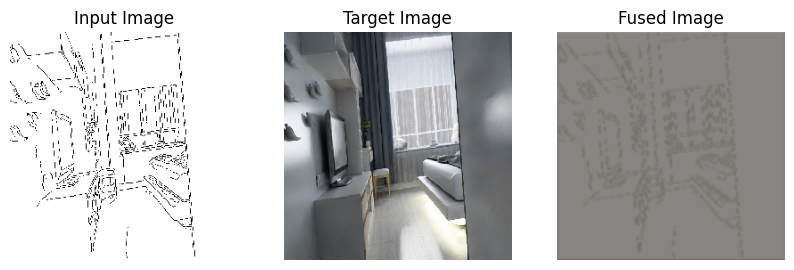

1/1 [==============================] - 0s 22ms/step


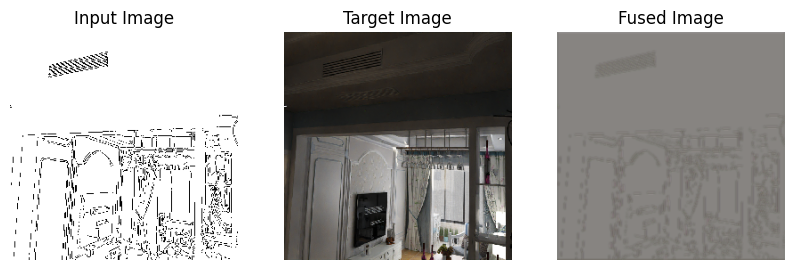

1/1 [==============================] - 0s 22ms/step


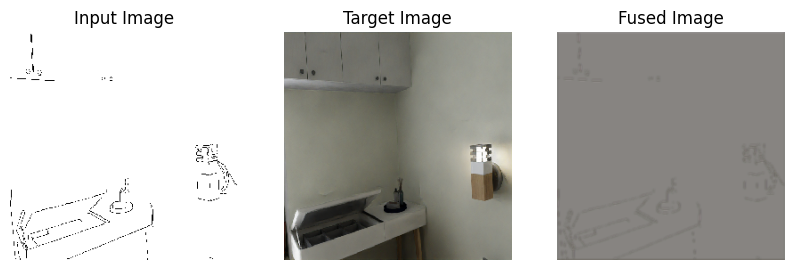

Epoch 6/20
1/1 [==============================] - 0s 21ms/step


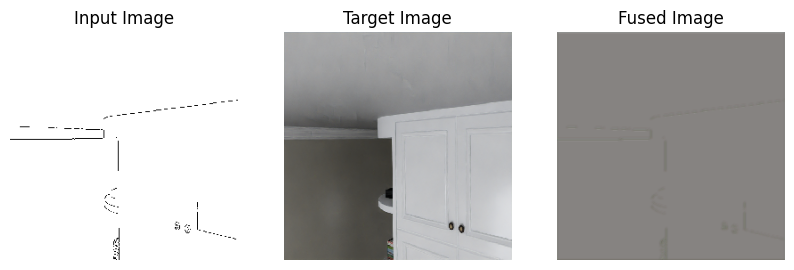

1/1 [==============================] - 0s 21ms/step


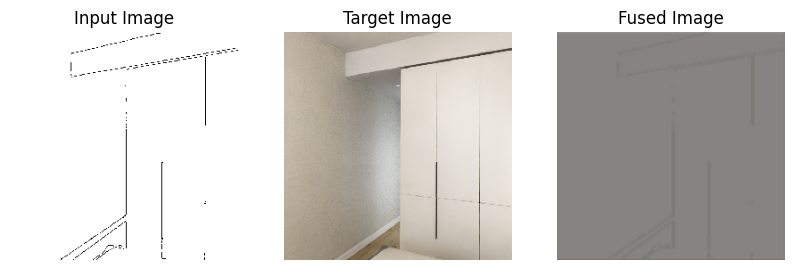

1/1 [==============================] - 0s 22ms/step


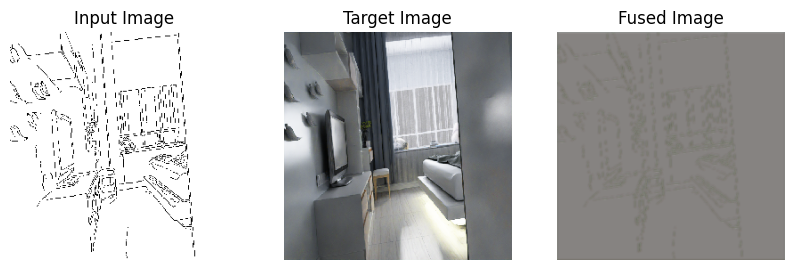

1/1 [==============================] - 0s 22ms/step


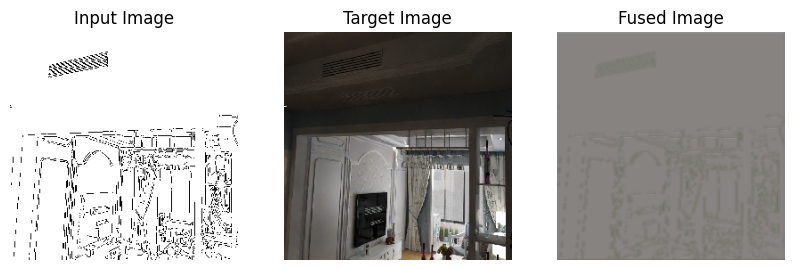

1/1 [==============================] - 0s 22ms/step


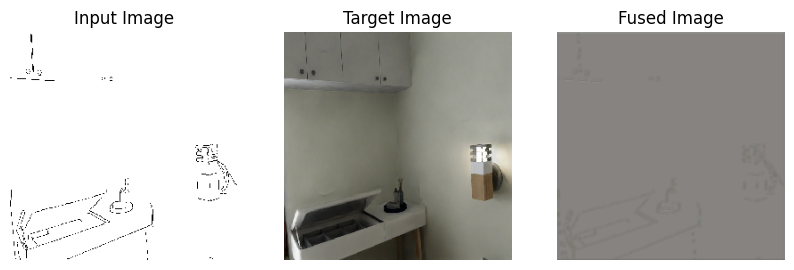

Epoch 7/20
14/78 [====>.........................] - ETA: 1:20 - loss: 0.0629

KeyboardInterrupt: 

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def visualize_fused_images(model, df, input_shape, save_dir=None):
    for i, row in df.iterrows():
        input_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_input, row['input_filename']), target_size=(input_shape[0], input_shape[1]))
        input_image = tf.keras.preprocessing.image.img_to_array(input_image)
        input_image = input_image / 255.0
        target_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_target, row['target_filename']), target_size=(input_shape[0], input_shape[1]))
        target_image = tf.keras.preprocessing.image.img_to_array(target_image)
        target_image = target_image / 255.0
        input_image_batch = np.expand_dims(input_image, axis=0)
        fused_image = model.predict([input_image_batch, input_image_batch])[0]

        # Display or save the fused image
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(input_image)
        plt.title('Input Image')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(target_image)
        plt.title('Target Image')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(fused_image, cmap='viridis')  # Use 'viridis' colormap for color images
        plt.title('Fused Image')
        plt.axis('off')

        if save_dir:
            plt.savefig(os.path.join(save_dir, f'fused_image_{i}.png'))
        else:
            plt.show()
        plt.close()


def feature_fusion_network(input_shape):
    # Define input layers for two images
    input_a = Input(shape=input_shape)
    input_b = Input(shape=input_shape)

    # Convolutional layers for each input
    conv_a = Conv2D(64, (3, 3), padding='same', activation='relu')(input_a)
    conv_b = Conv2D(64, (3, 3), padding='same', activation='relu')(input_b)

    # Concatenate the feature maps
    concatenated_features = Concatenate(axis=-1)([conv_a, conv_b])

    # Convolutional layer after concatenation
    conv_fusion = Conv2D(64, (3, 3), padding='same', activation='relu')(concatenated_features)

    # Output layer
    output = Conv2D(3, (1, 1), padding='same', activation='sigmoid')(conv_fusion)  # Adjusted for RGB image

    # Define model
    model = Model(inputs=[input_a, input_b], outputs=output)

    return model

# Define directories containing your training images
train_dir_input = '/content/drive/MyDrive/train5000/sketches'
train_dir_target = '/content/drive/MyDrive/train5000/images'

# Get list of input image files
input_image_files = sorted([filename for filename in os.listdir(train_dir_input) if filename.endswith('.png')])
# Get list of target image files
target_image_files = sorted([filename for filename in os.listdir(train_dir_target) if filename.endswith('.png')])

# Pair input and target images based on filename matching
paired_files = []
for input_file in input_image_files:
    input_basename = os.path.splitext(input_file)[0]
    for target_file in target_image_files:
        target_basename = os.path.splitext(target_file)[0]
        if input_basename.split('_')[0] == target_basename:
            paired_files.append((input_file, target_file))
            break

# Create DataFrame from paired files
df = pd.DataFrame(paired_files, columns=['input_filename', 'target_filename'])

# Shuffle the DataFrame
df = df.sample(frac=1).reset_index(drop=True)

# Define image data generators with rescaling
datagen_input = ImageDataGenerator(rescale=1./255)
datagen_target = ImageDataGenerator(rescale=1./255)

# Set batch size and image dimensions
batch_size = 64
input_shape = (256, 256, 3)  # Adjust according to your images


# Create a generator that yields tuples of (input_image, target_image)
def image_generator(df, batch_size, input_shape):
    while True:
        for i in range(0, len(df), batch_size):
            batch_df = df[i:i+batch_size]
            inputs = []
            targets = []
            for _, row in batch_df.iterrows():
                input_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_input, row['input_filename']), target_size=(input_shape[0], input_shape[1]))
                input_image = tf.keras.preprocessing.image.img_to_array(input_image)
                input_image = input_image / 255.0  # Normalize input image
                target_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_target, row['target_filename']), target_size=(input_shape[0], input_shape[1]))
                target_image = tf.keras.preprocessing.image.img_to_array(target_image)
                target_image = target_image / 255.0  # Normalize target image
                inputs.append(input_image)
                targets.append(target_image)
            yield ([np.array(inputs), np.array(inputs)], np.array(targets))

# Create the generator
generator = image_generator(df, batch_size, input_shape)

# Define the model
ffn_model = feature_fusion_network(input_shape)

# Compile the model
ffn_model.compile(optimizer='adam', loss='mean_squared_error')

# Define the path to save the weights
weights_path = '/content/drive/MyDrive/ffnweights'

# Define checkpoint callback to save the model weights after each epoch
checkpoint_callback = ModelCheckpoint('/content/drive/MyDrive/ffnweights/weights_epoch_{epoch:02d}.h5', save_weights_only=True)

# Train the model
for epoch in range(20):
    print(f"Epoch {epoch + 1}/{20}")
    history = ffn_model.fit(
        generator,
        epochs=1,
        steps_per_epoch=len(df) // batch_size,
        callbacks=[checkpoint_callback]
    )
    visualize_fused_images(ffn_model, df.head(5), input_shape)


Epoch 1/20
1/1 [==============================] - 0s 205ms/step


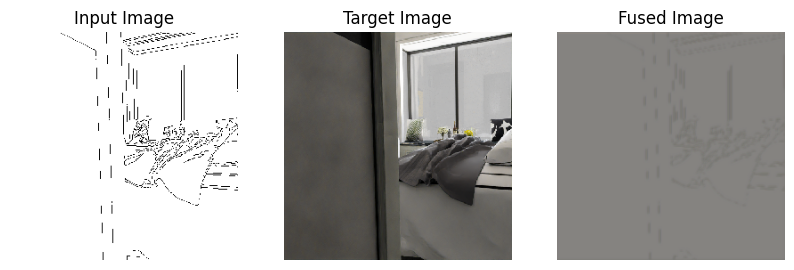

1/1 [==============================] - 0s 21ms/step


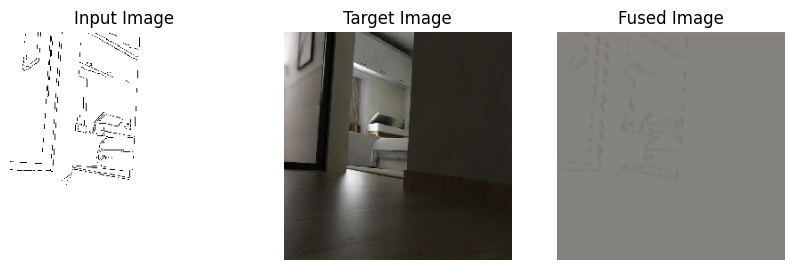

1/1 [==============================] - 0s 20ms/step


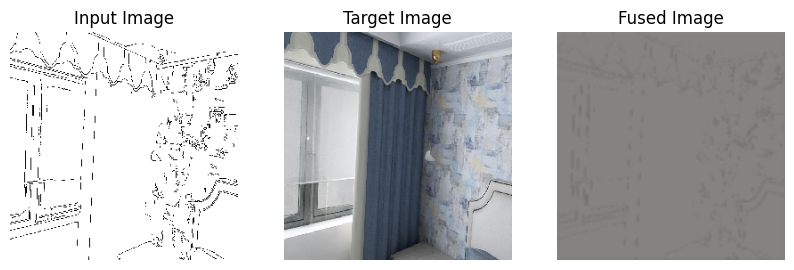

1/1 [==============================] - 0s 21ms/step


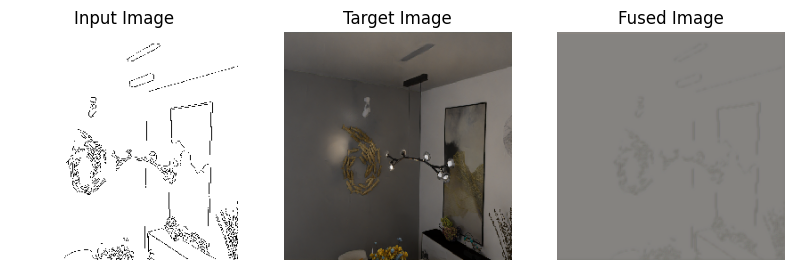

1/1 [==============================] - 0s 20ms/step


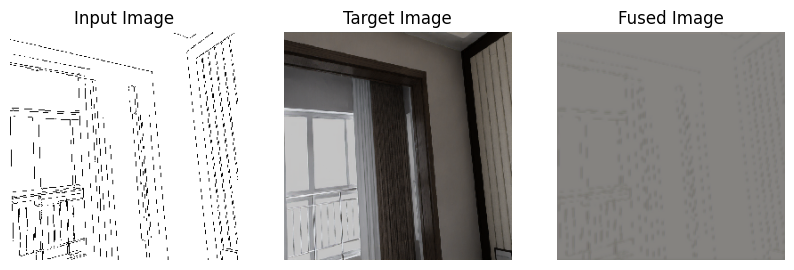

Epoch 2/20
1/1 [==============================] - 0s 22ms/step


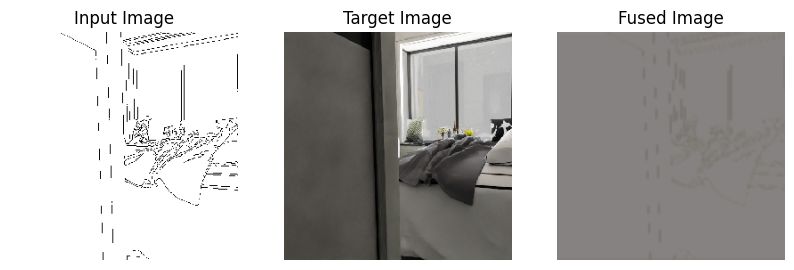

1/1 [==============================] - 0s 21ms/step


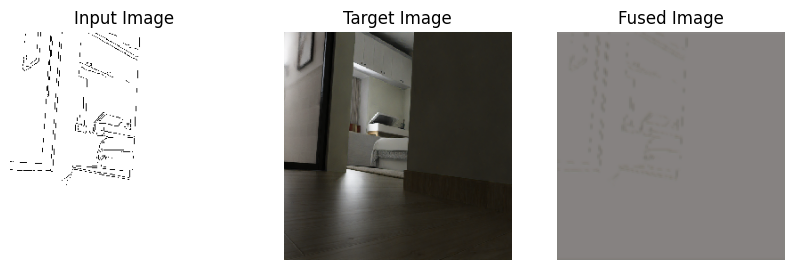

1/1 [==============================] - 0s 21ms/step


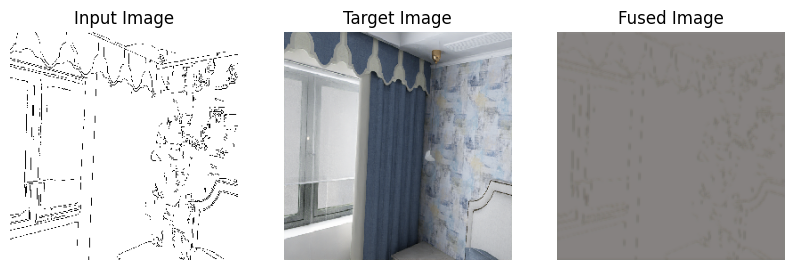

1/1 [==============================] - 0s 21ms/step


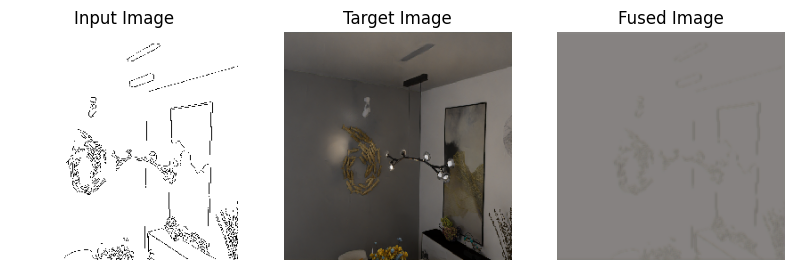

1/1 [==============================] - 0s 22ms/step


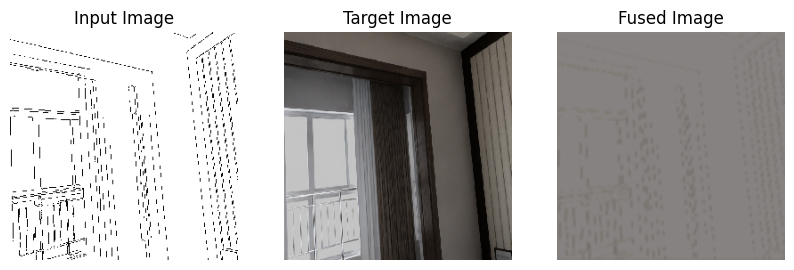

Epoch 3/20
1/1 [==============================] - 0s 23ms/step


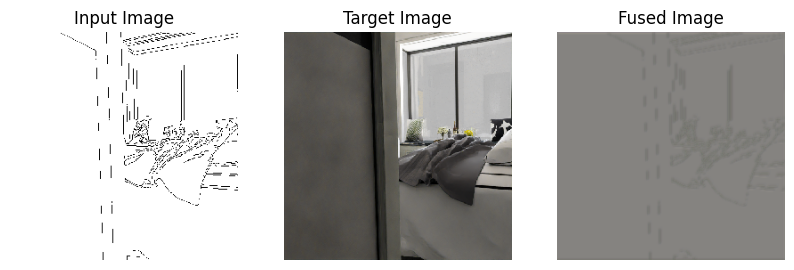

1/1 [==============================] - 0s 20ms/step


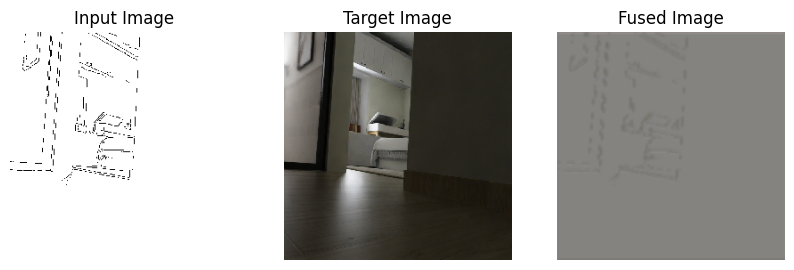

1/1 [==============================] - 0s 20ms/step


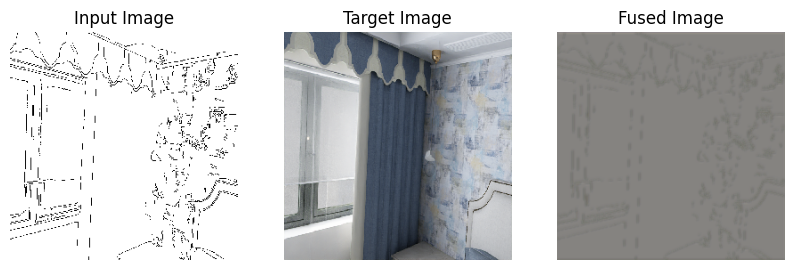

1/1 [==============================] - 0s 20ms/step


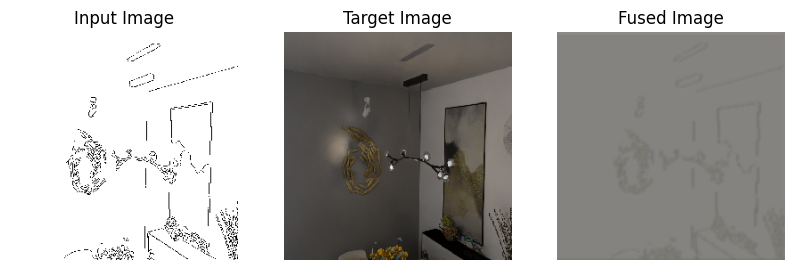

1/1 [==============================] - 0s 20ms/step


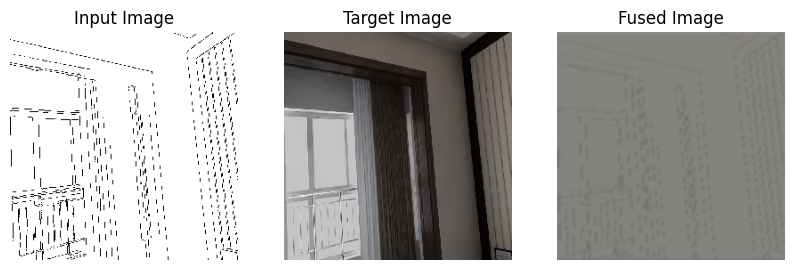

Epoch 4/20
1/1 [==============================] - 0s 21ms/step


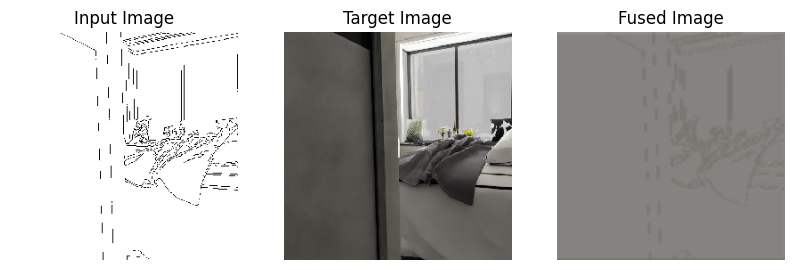

1/1 [==============================] - 0s 31ms/step


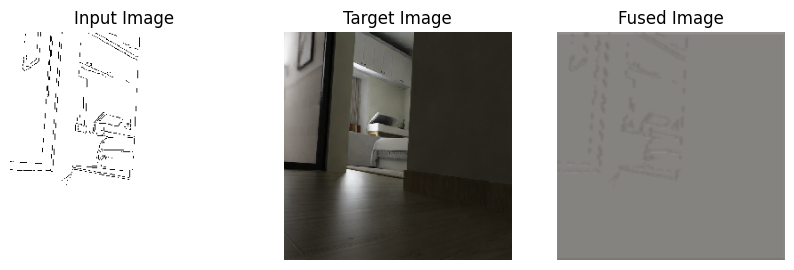

1/1 [==============================] - 0s 20ms/step


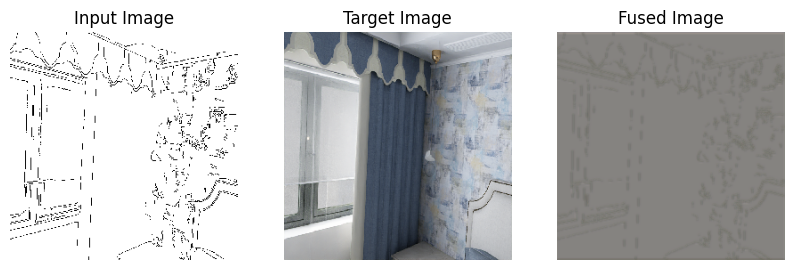

1/1 [==============================] - 0s 20ms/step


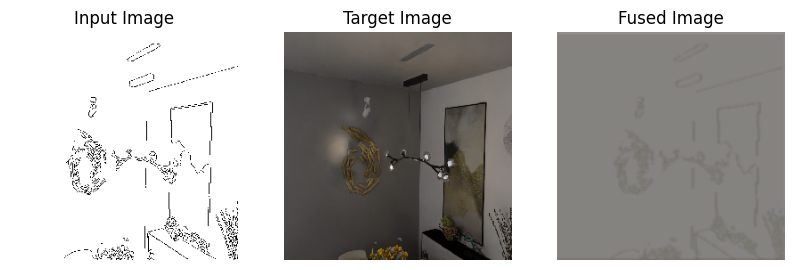

1/1 [==============================] - 0s 32ms/step


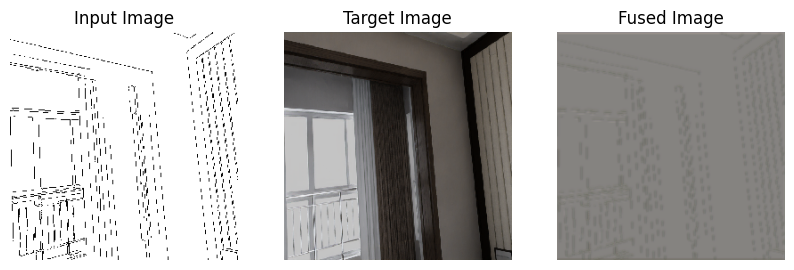

Epoch 5/20
1/1 [==============================] - 0s 22ms/step


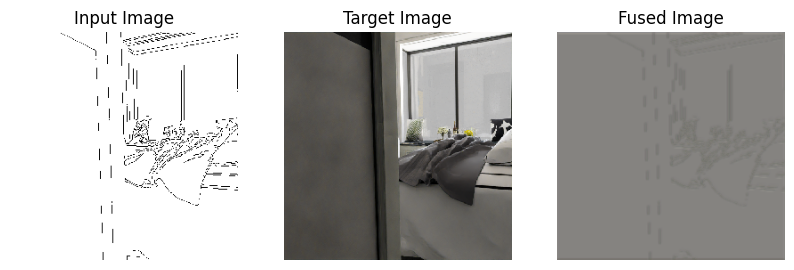

1/1 [==============================] - 0s 20ms/step


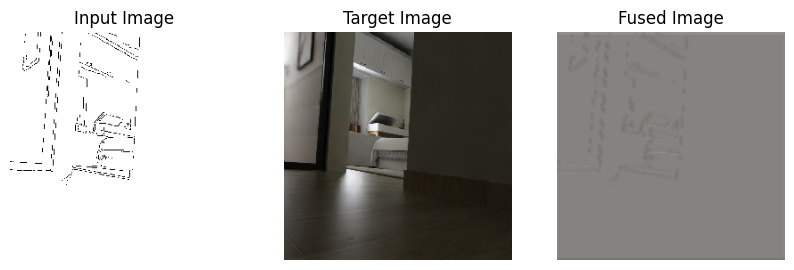

1/1 [==============================] - 0s 22ms/step


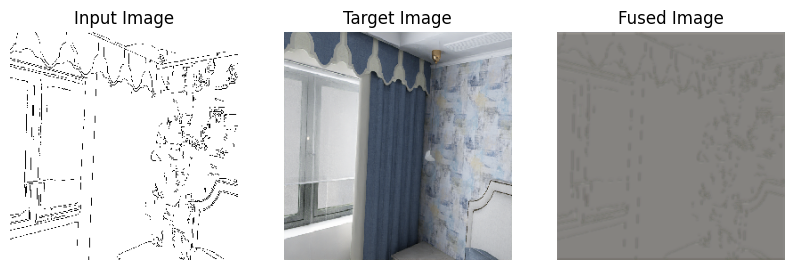

1/1 [==============================] - 0s 22ms/step


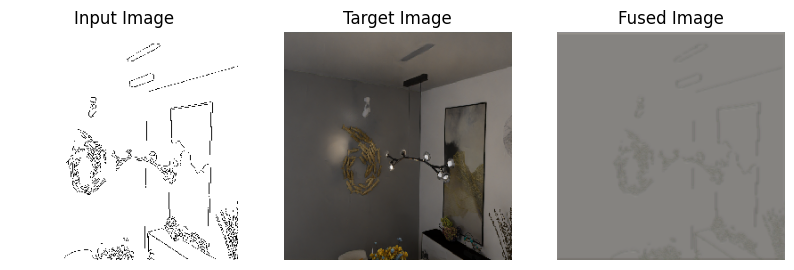

1/1 [==============================] - 0s 25ms/step


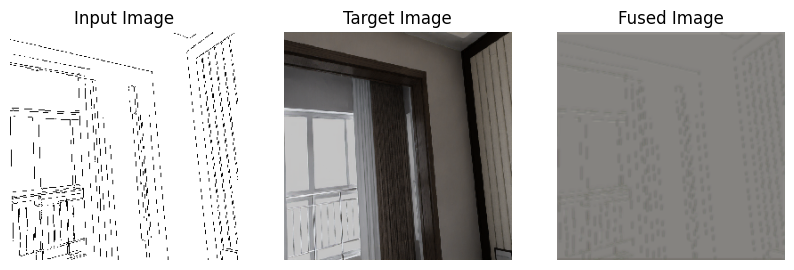

Epoch 6/20
1/1 [==============================] - 0s 22ms/step


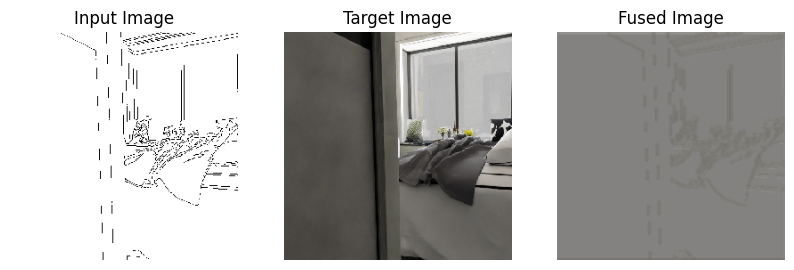

1/1 [==============================] - 0s 21ms/step


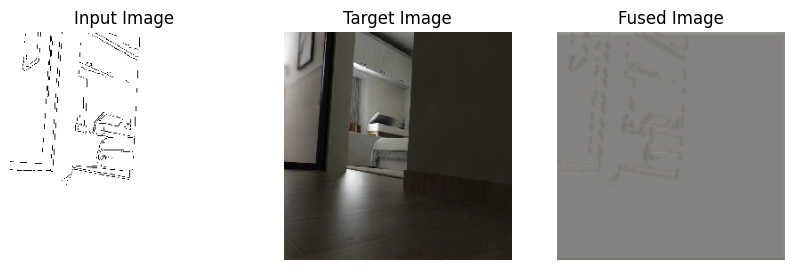

1/1 [==============================] - 0s 35ms/step


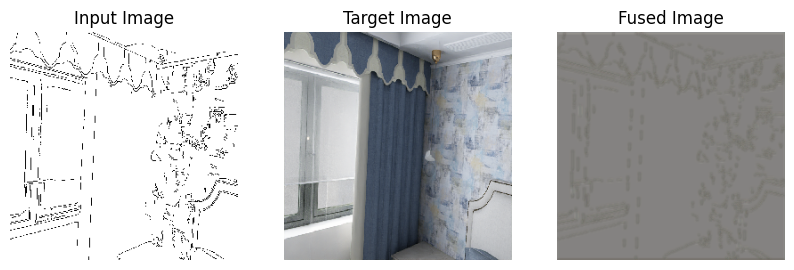

1/1 [==============================] - 0s 21ms/step


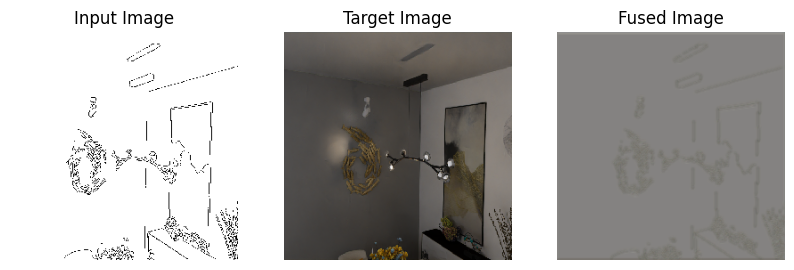

1/1 [==============================] - 0s 21ms/step


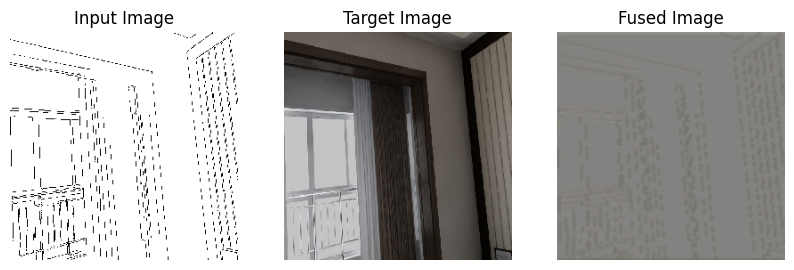

Epoch 7/20
1/1 [==============================] - 0s 21ms/step


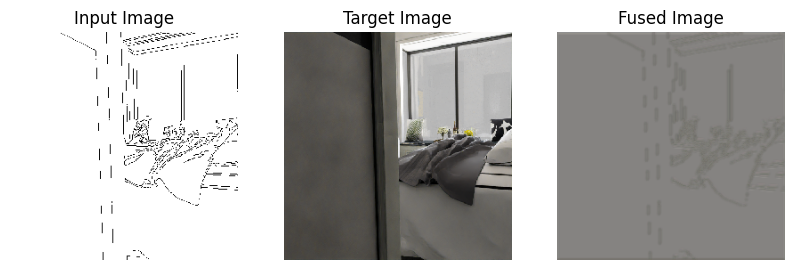

1/1 [==============================] - 0s 22ms/step


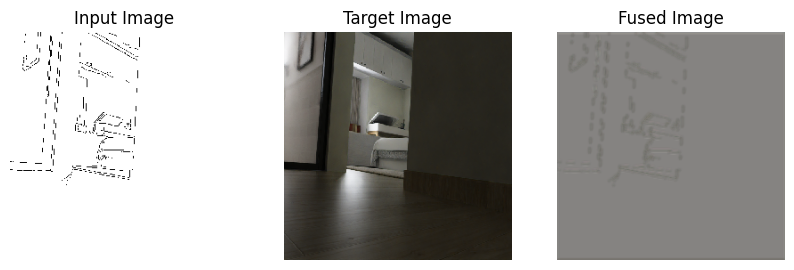

1/1 [==============================] - 0s 20ms/step


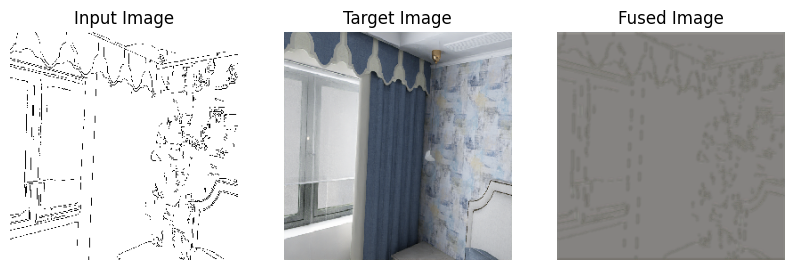

1/1 [==============================] - 0s 21ms/step


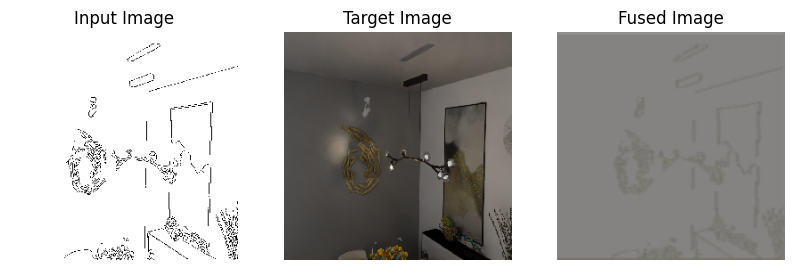

1/1 [==============================] - 0s 20ms/step


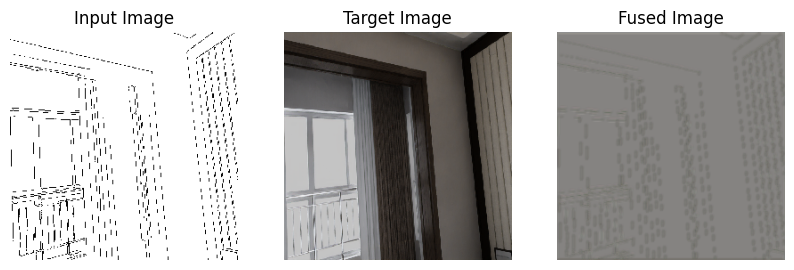

Epoch 8/20
1/1 [==============================] - 0s 21ms/step


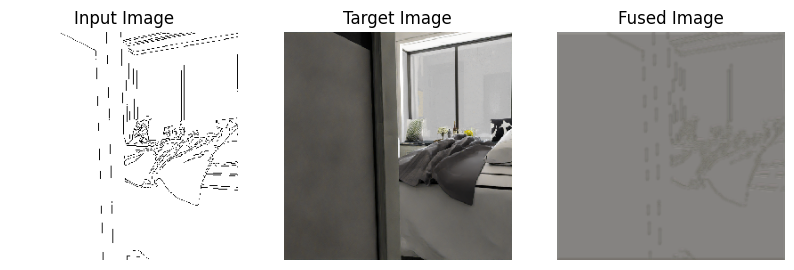

1/1 [==============================] - 0s 20ms/step


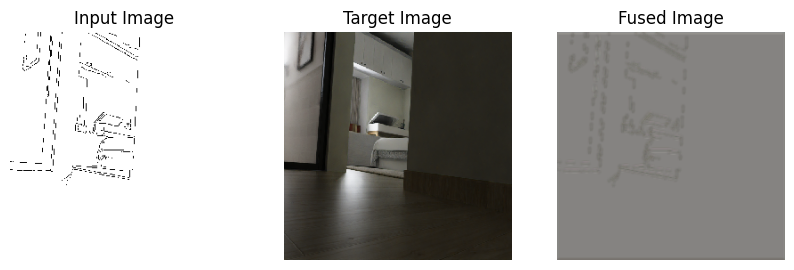

1/1 [==============================] - 0s 21ms/step


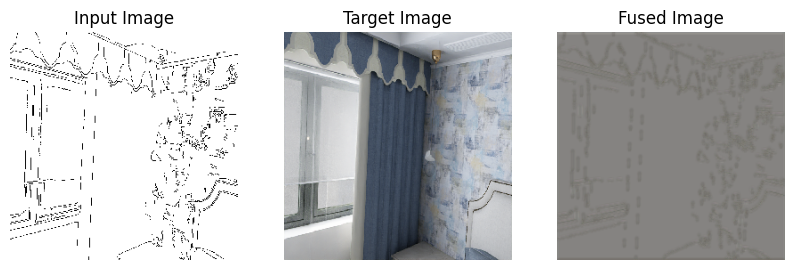

1/1 [==============================] - 0s 22ms/step


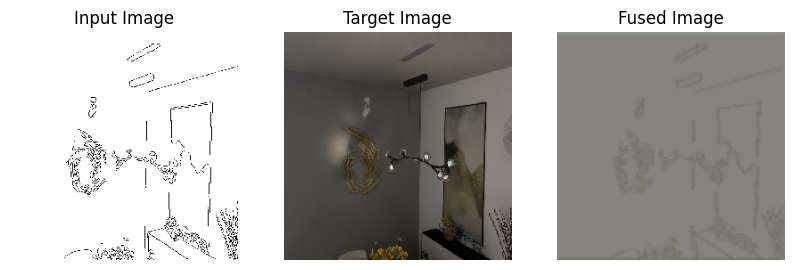

1/1 [==============================] - 0s 21ms/step


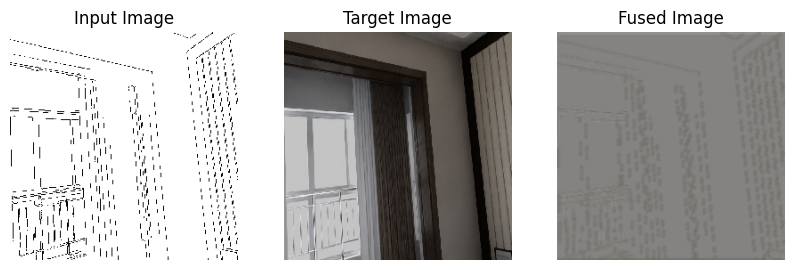

Epoch 9/20
1/1 [==============================] - 0s 21ms/step


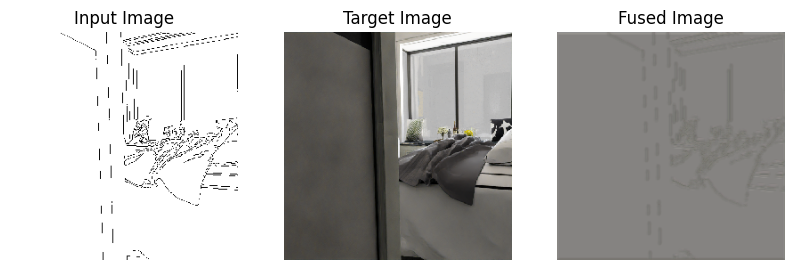

1/1 [==============================] - 0s 21ms/step


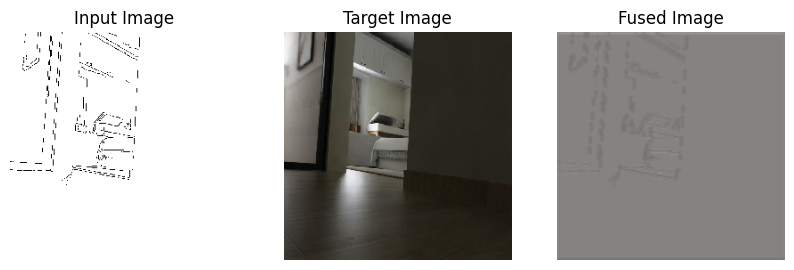

1/1 [==============================] - 0s 21ms/step


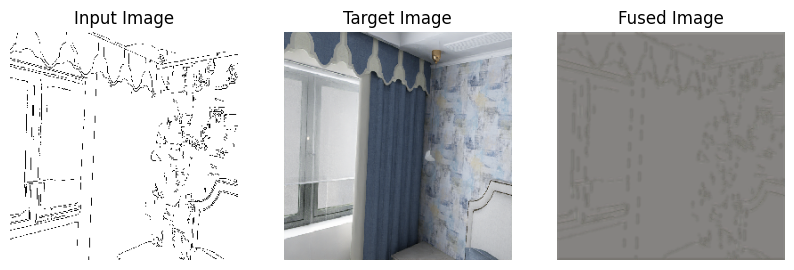

1/1 [==============================] - 0s 21ms/step


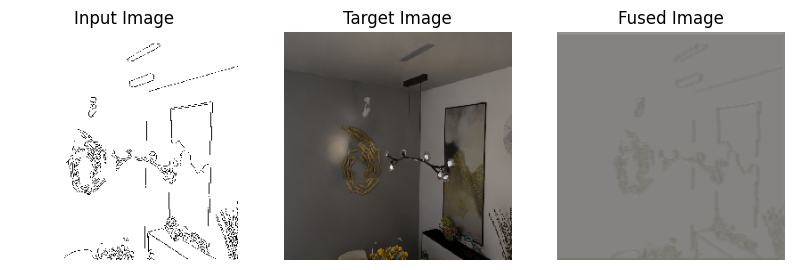

1/1 [==============================] - 0s 21ms/step


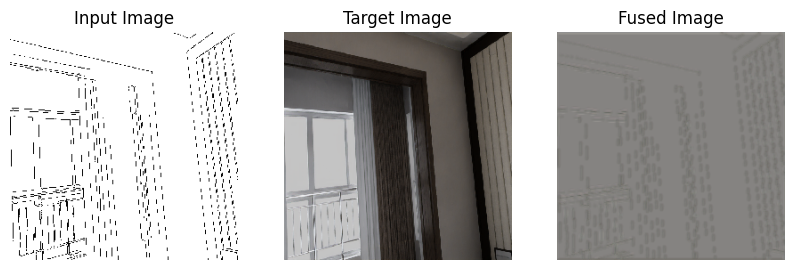

Epoch 10/20
1/1 [==============================] - 0s 21ms/step


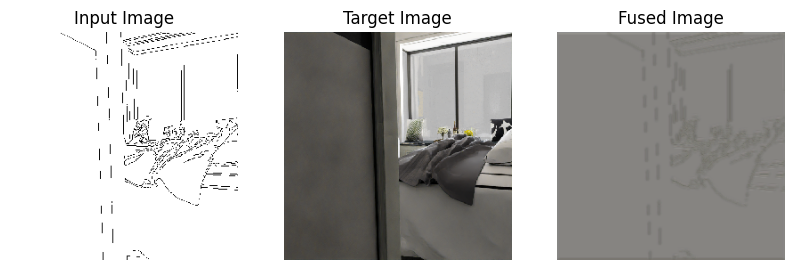

1/1 [==============================] - 0s 21ms/step


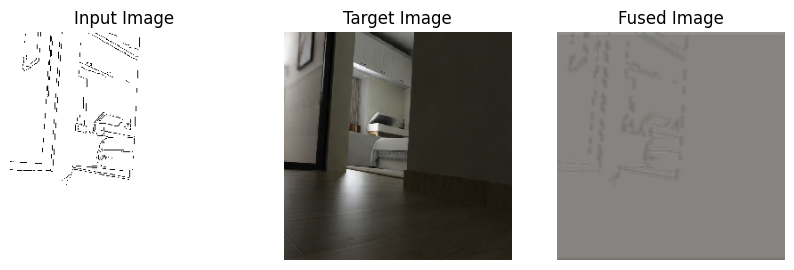

1/1 [==============================] - 0s 21ms/step


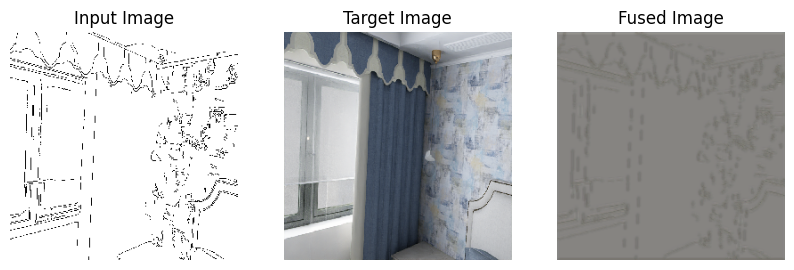

1/1 [==============================] - 0s 20ms/step


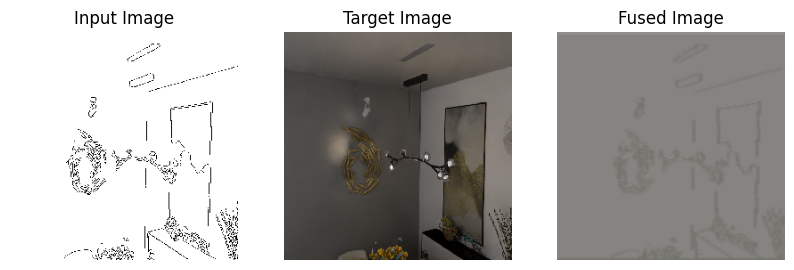

1/1 [==============================] - 0s 20ms/step


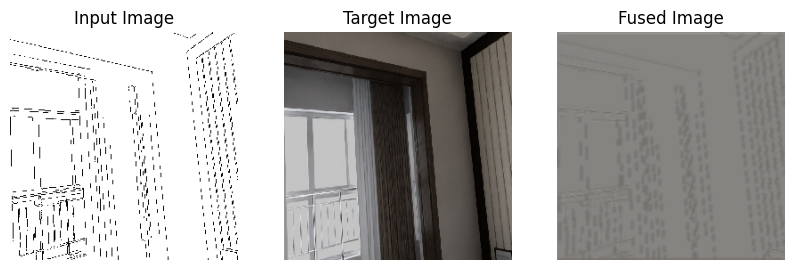

Epoch 11/20
1/1 [==============================] - 0s 21ms/step


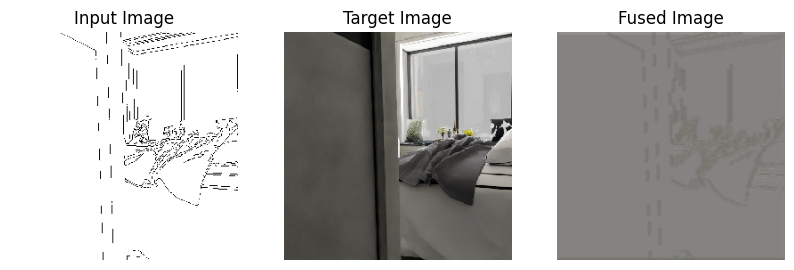

1/1 [==============================] - 0s 20ms/step


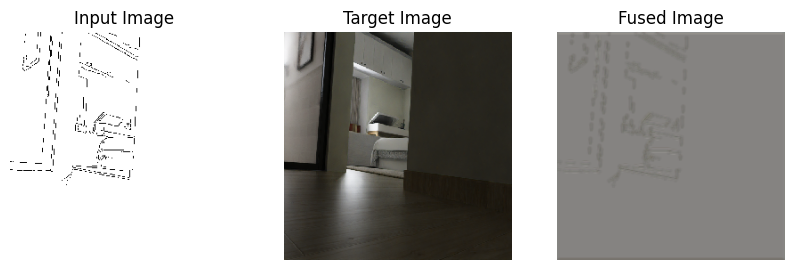

1/1 [==============================] - 0s 20ms/step


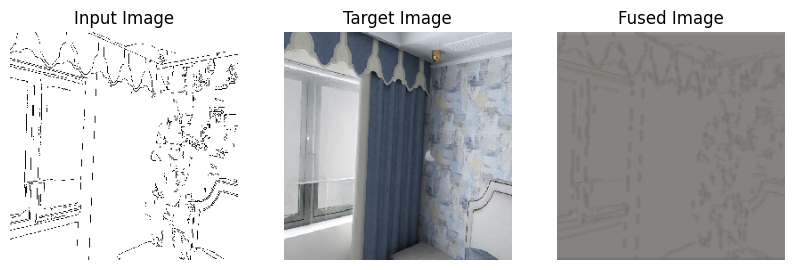

1/1 [==============================] - 0s 21ms/step


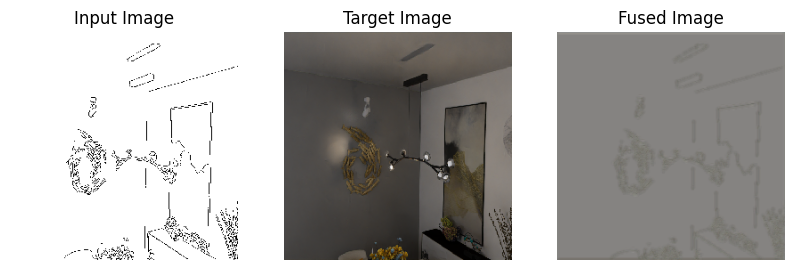

1/1 [==============================] - 0s 21ms/step


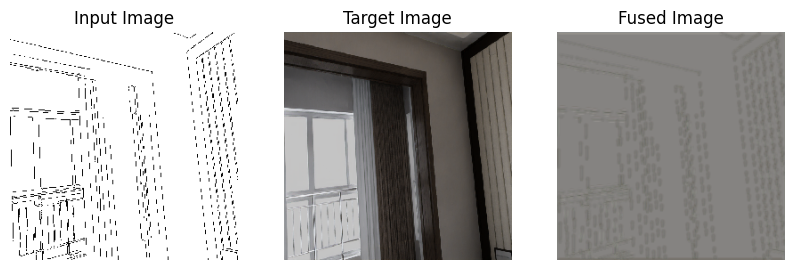

Epoch 12/20
1/1 [==============================] - 0s 22ms/step


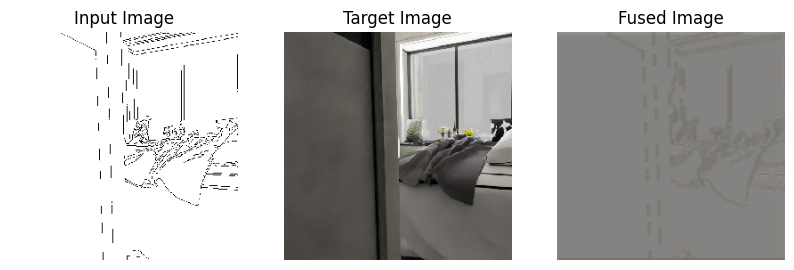

1/1 [==============================] - 0s 21ms/step


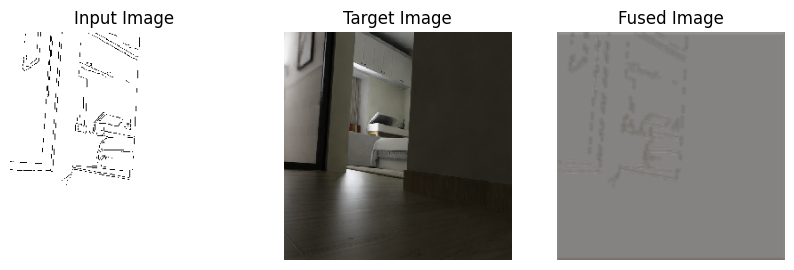

1/1 [==============================] - 0s 22ms/step


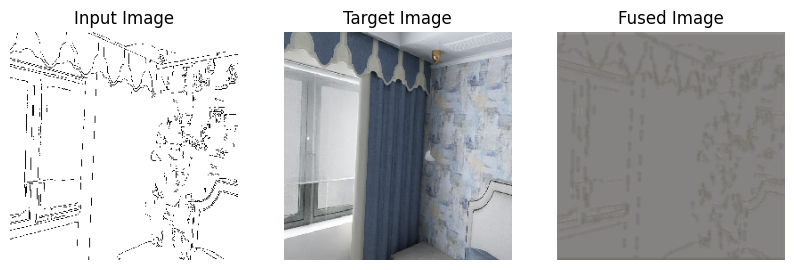

1/1 [==============================] - 0s 20ms/step


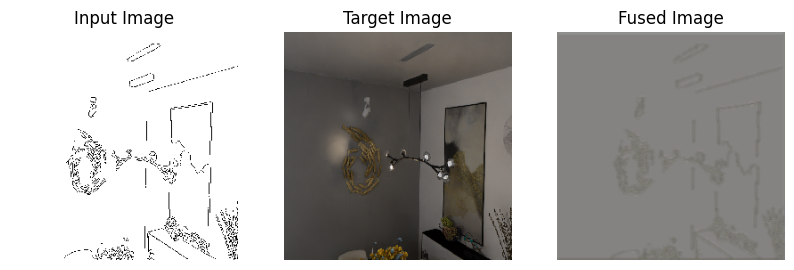

1/1 [==============================] - 0s 22ms/step


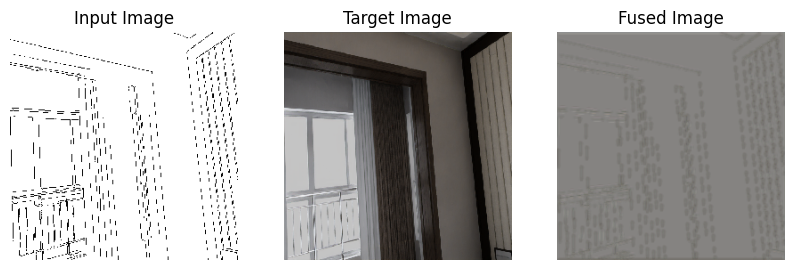

Epoch 13/20
1/1 [==============================] - 0s 22ms/step


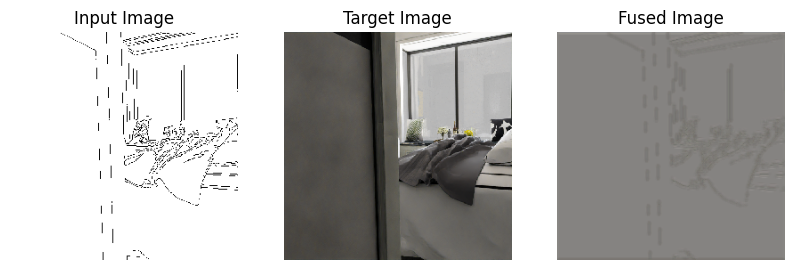

1/1 [==============================] - 0s 21ms/step


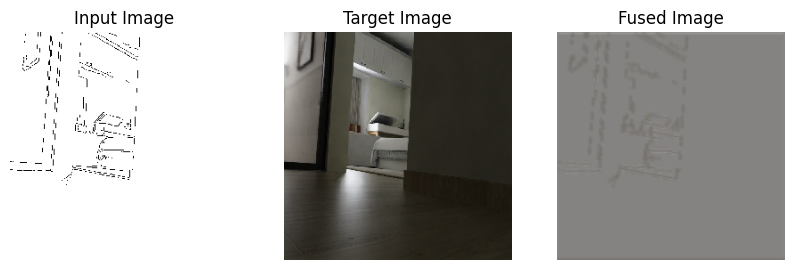

1/1 [==============================] - 0s 20ms/step


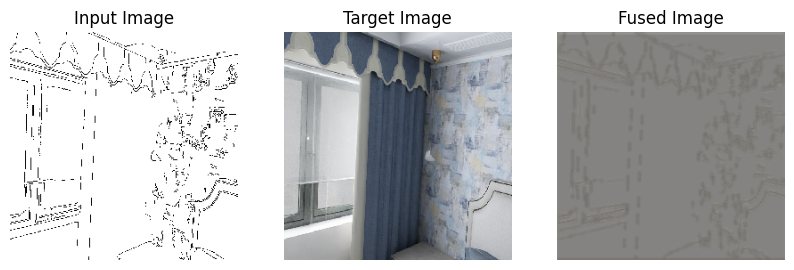

1/1 [==============================] - 0s 21ms/step


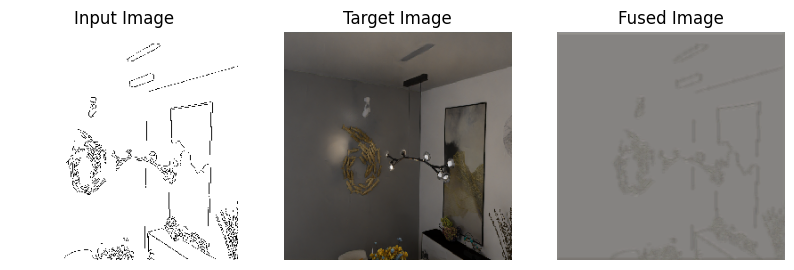

1/1 [==============================] - 0s 21ms/step


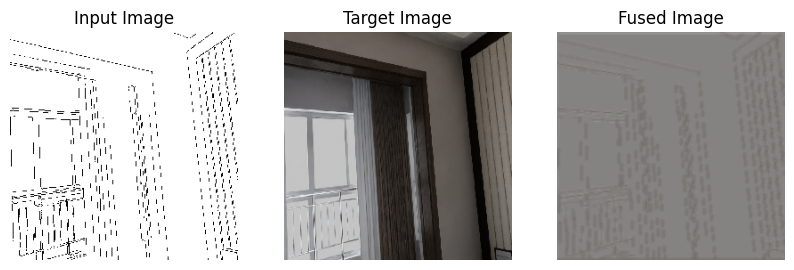

Epoch 14/20
1/1 [==============================] - 0s 21ms/step


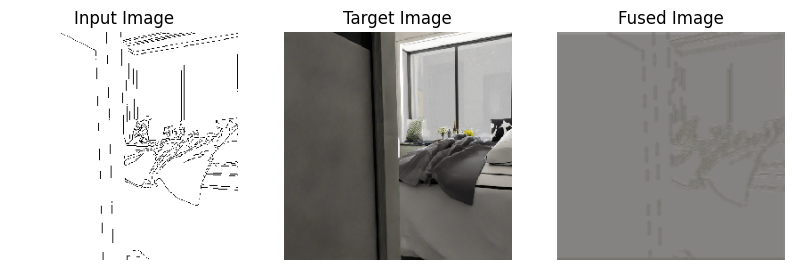

1/1 [==============================] - 0s 20ms/step


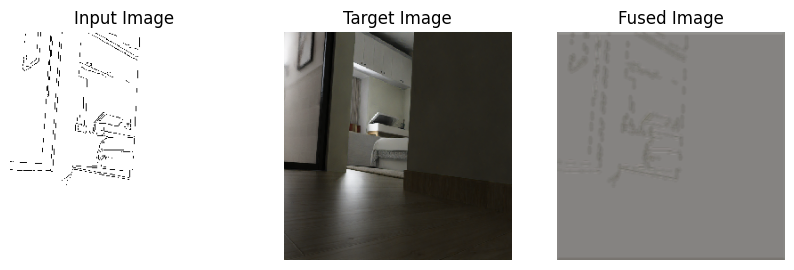

1/1 [==============================] - 0s 21ms/step


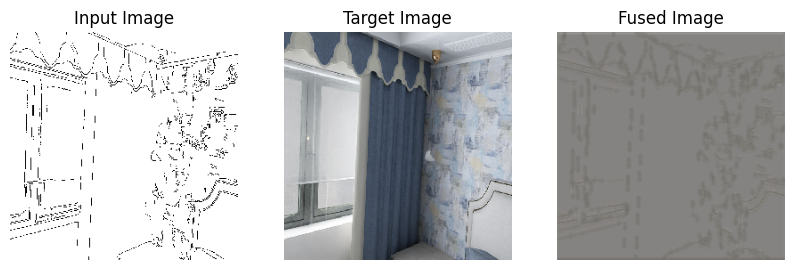

1/1 [==============================] - 0s 21ms/step


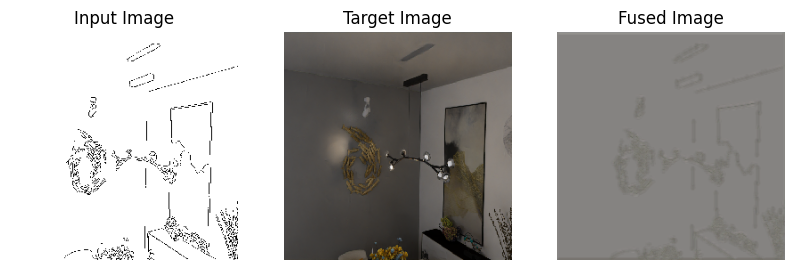

1/1 [==============================] - 0s 21ms/step


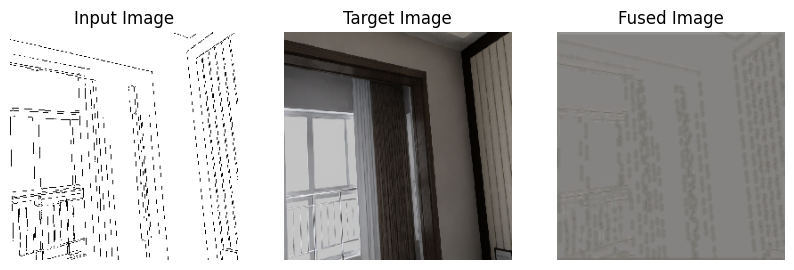

Epoch 15/20
1/1 [==============================] - 0s 21ms/step


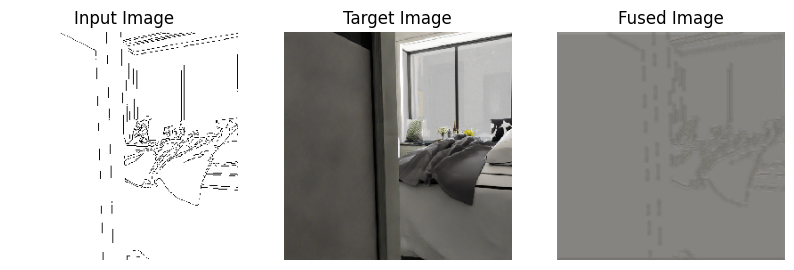

1/1 [==============================] - 0s 21ms/step


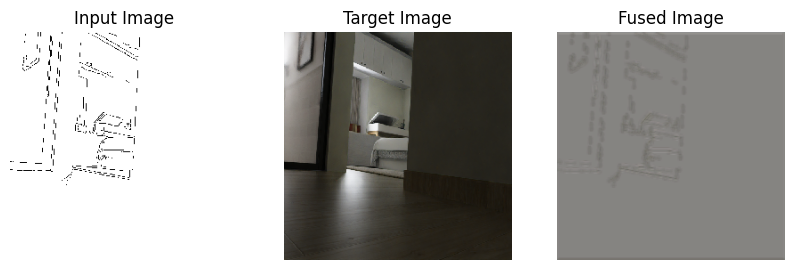

1/1 [==============================] - 0s 21ms/step


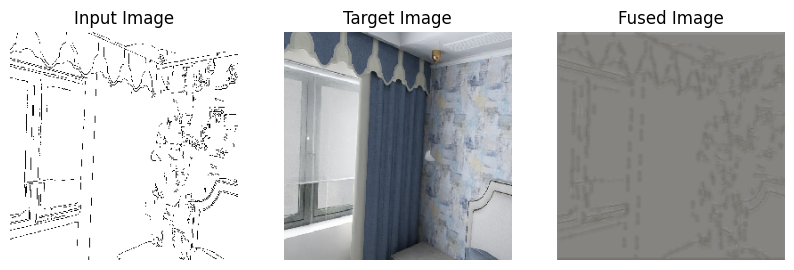

1/1 [==============================] - 0s 21ms/step


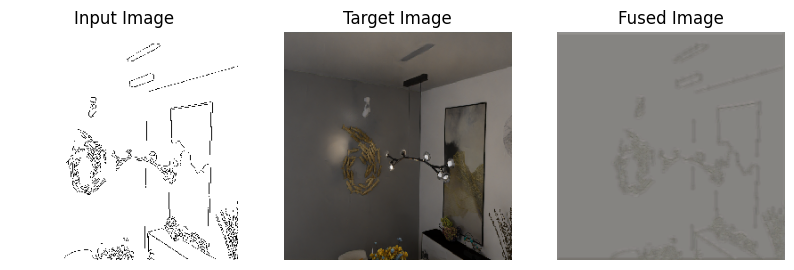

1/1 [==============================] - 0s 22ms/step


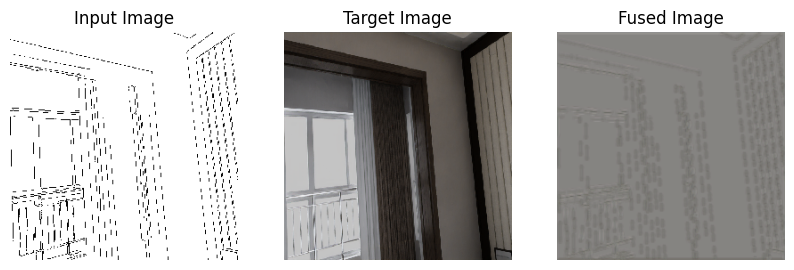

Epoch 16/20
1/1 [==============================] - 0s 22ms/step


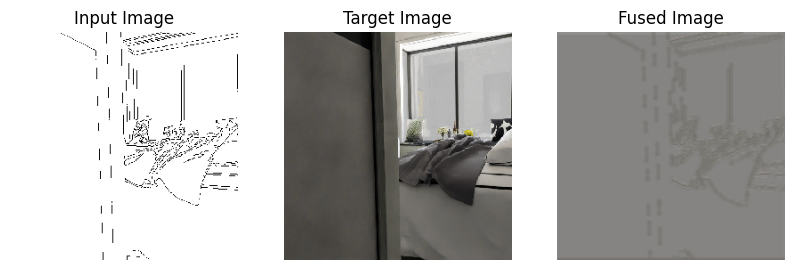

1/1 [==============================] - 0s 21ms/step


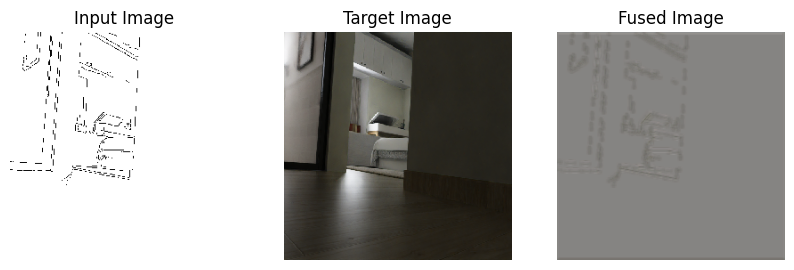

1/1 [==============================] - 0s 22ms/step


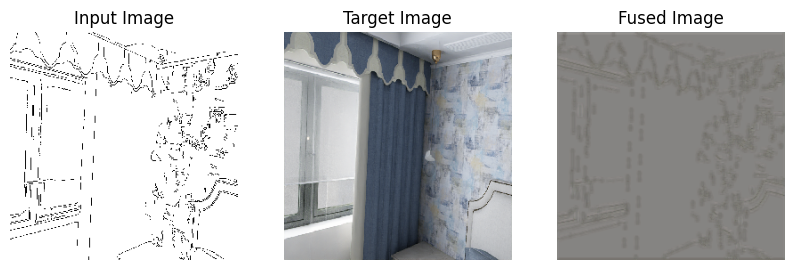

1/1 [==============================] - 0s 21ms/step


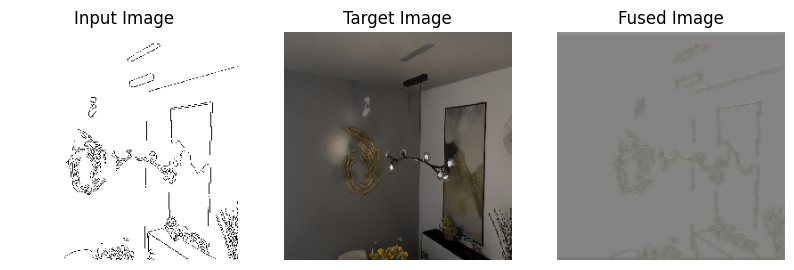

1/1 [==============================] - 0s 21ms/step


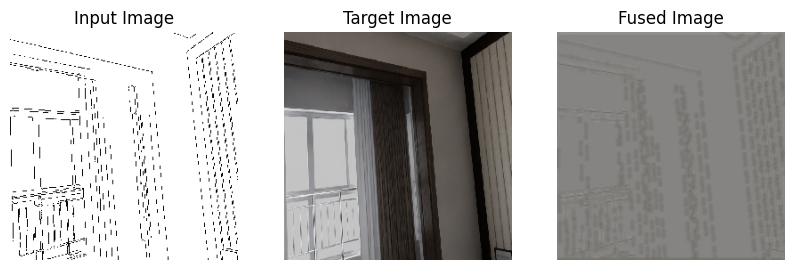

Epoch 17/20
1/1 [==============================] - 0s 22ms/step


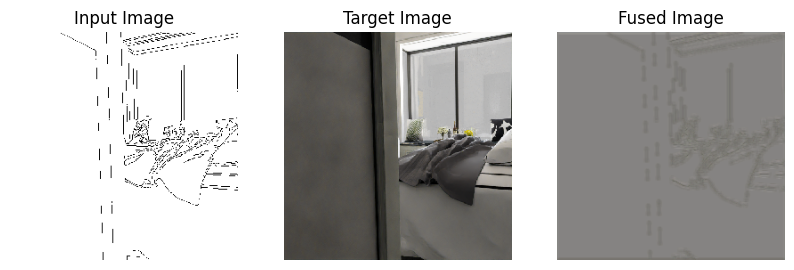

1/1 [==============================] - 0s 20ms/step


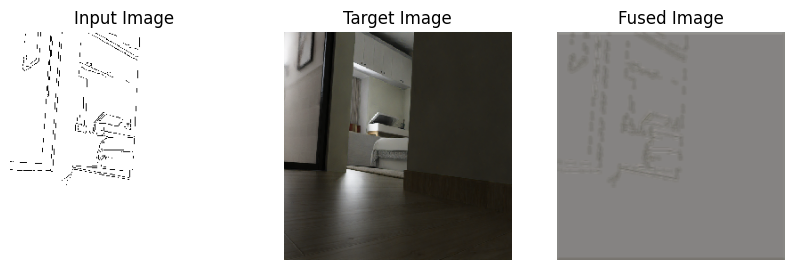

1/1 [==============================] - 0s 21ms/step


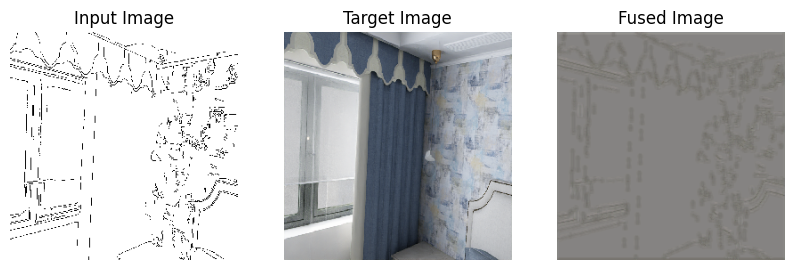

1/1 [==============================] - 0s 21ms/step


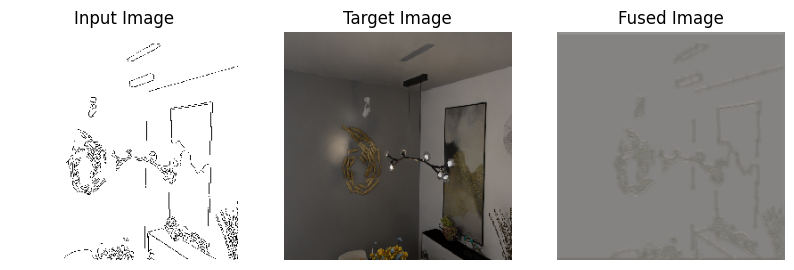

1/1 [==============================] - 0s 22ms/step


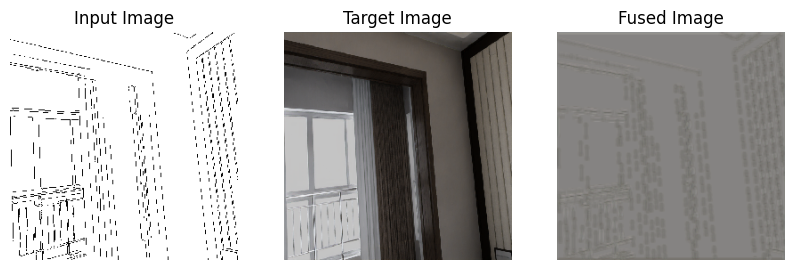

Epoch 18/20
1/1 [==============================] - 0s 22ms/step


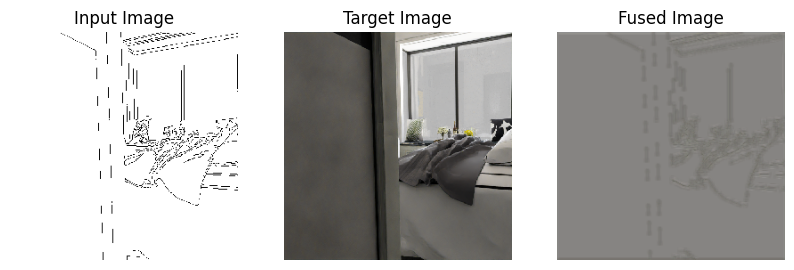

1/1 [==============================] - 0s 22ms/step


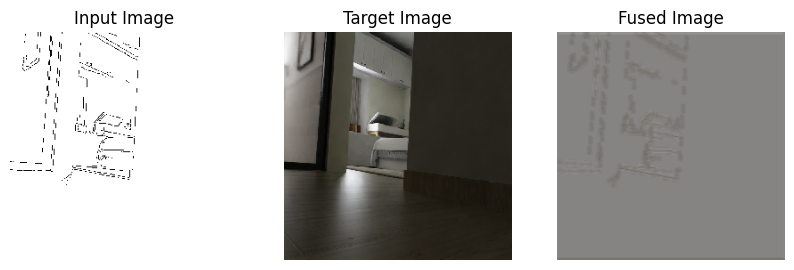

1/1 [==============================] - 0s 21ms/step


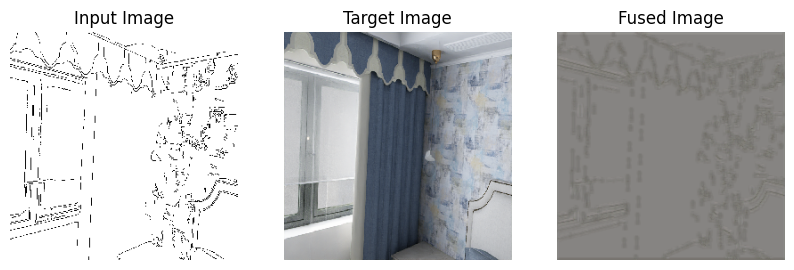

1/1 [==============================] - 0s 22ms/step


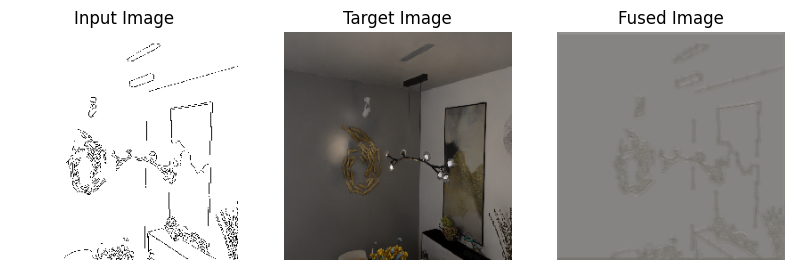

1/1 [==============================] - 0s 21ms/step


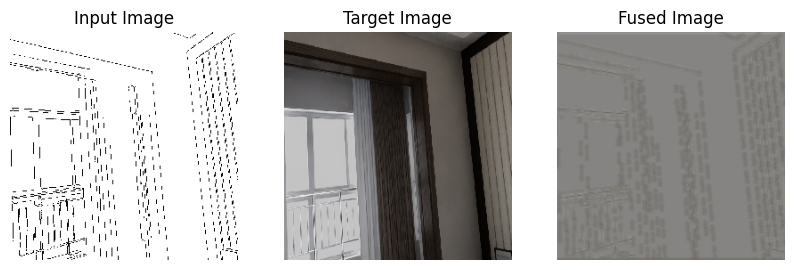

Epoch 19/20
1/1 [==============================] - 0s 21ms/step


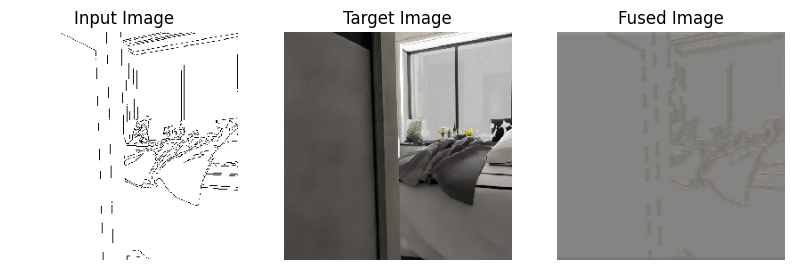

1/1 [==============================] - 0s 20ms/step


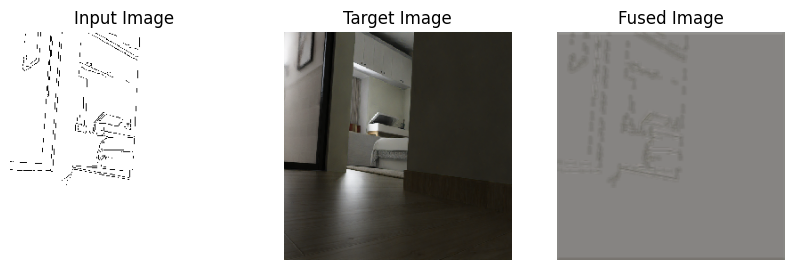

1/1 [==============================] - 0s 21ms/step


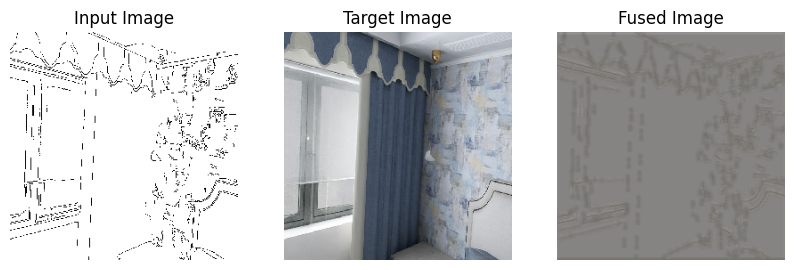

1/1 [==============================] - 0s 21ms/step


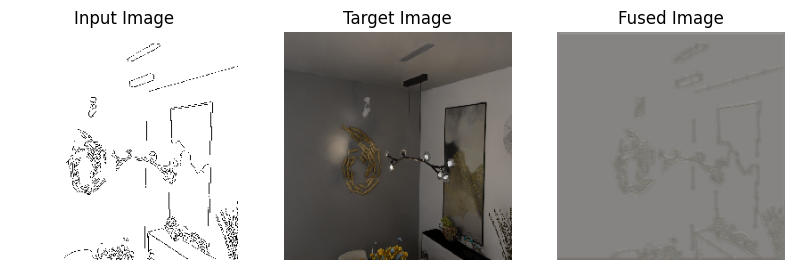

1/1 [==============================] - 0s 27ms/step


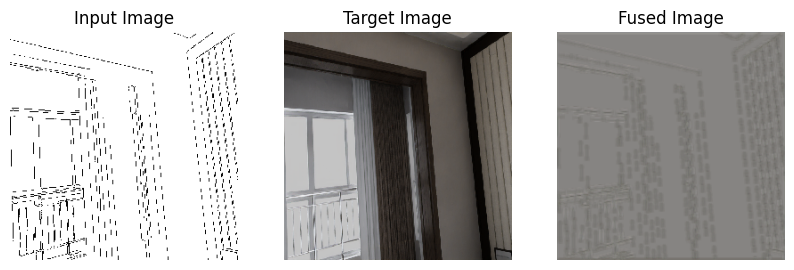

Epoch 20/20
1/1 [==============================] - 0s 21ms/step


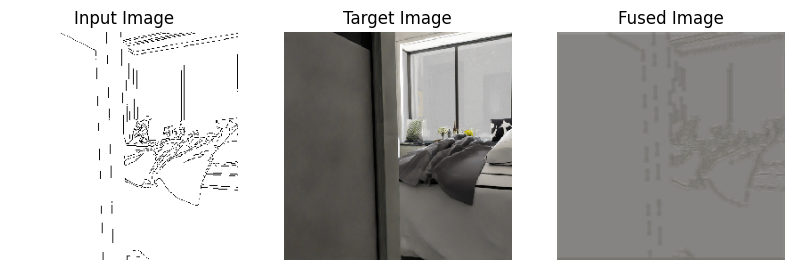

1/1 [==============================] - 0s 21ms/step


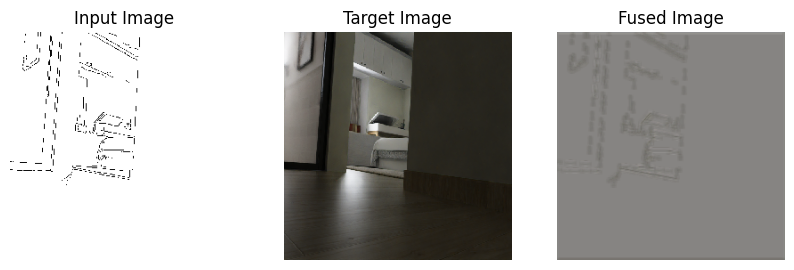

1/1 [==============================] - 0s 21ms/step


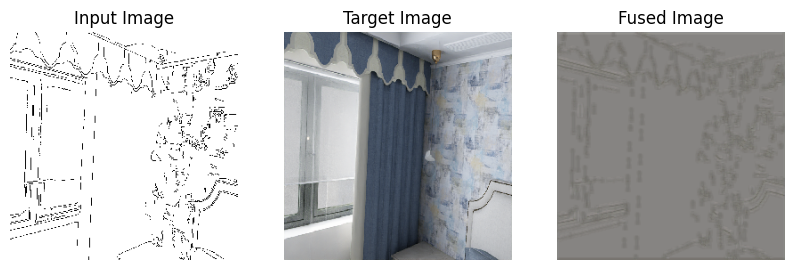

1/1 [==============================] - 0s 21ms/step


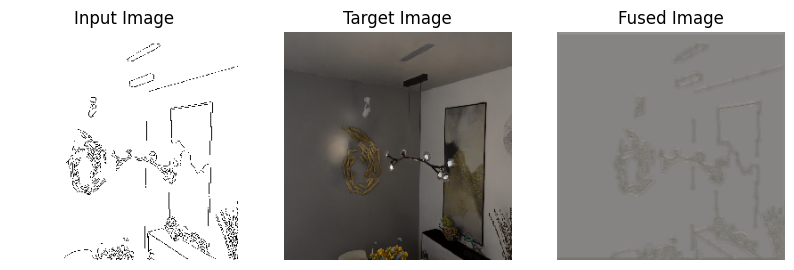

1/1 [==============================] - 0s 22ms/step


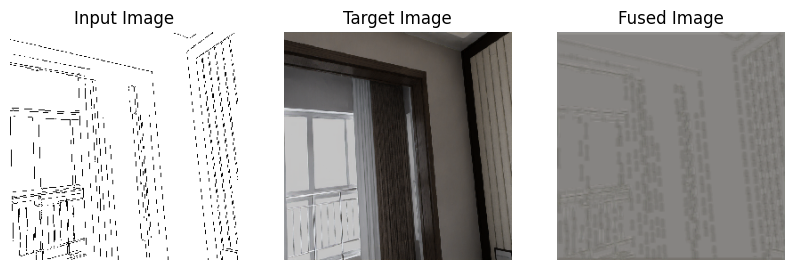

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def visualize_fused_images(model, df, input_shape, save_dir=None):
    for i, row in df.iterrows():
        input_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_input, row['input_filename']), target_size=(input_shape[0], input_shape[1]))
        input_image = tf.keras.preprocessing.image.img_to_array(input_image)
        input_image /= 255.0
        target_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_target, row['target_filename']), target_size=(input_shape[0], input_shape[1]))
        target_image = tf.keras.preprocessing.image.img_to_array(target_image)
        target_image /= 255.0
        input_image_batch = np.expand_dims(input_image, axis=0)
        fused_image = model.predict(input_image_batch)[0]

        plt.figure(figsize=(10, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(input_image)
        plt.title('Input Image')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(target_image)
        plt.title('Target Image')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(fused_image, cmap='viridis')
        plt.title('Fused Image')
        plt.axis('off')

        if save_dir:
            plt.savefig(os.path.join(save_dir, f'fused_image_{i}.png'))
        else:
            plt.show()
        plt.close()

def feature_fusion_network(input_shape):
    input_layer = Input(shape=input_shape)
    conv1 = Conv2D(64, (3, 3), padding='same', activation='relu')(input_layer)
    conv2 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv1)
    conv3 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv2)
    output = Conv2D(3, (1, 1), padding='same', activation='sigmoid')(conv3)
    model = Model(inputs=input_layer, outputs=output)
    return model

train_dir_input = '/content/drive/MyDrive/train5000/sketches'
train_dir_target = '/content/drive/MyDrive/train5000/images'

input_image_files = sorted([filename for filename in os.listdir(train_dir_input) if filename.endswith('.png')])
target_image_files = sorted([filename for filename in os.listdir(train_dir_target) if filename.endswith('.png')])

paired_files = []
for input_file in input_image_files:
    input_basename = os.path.splitext(input_file)[0]
    for target_file in target_image_files:
        target_basename = os.path.splitext(target_file)[0]
        if input_basename.split('_')[0] == target_basename:
            paired_files.append((input_file, target_file))
            break

df = pd.DataFrame(paired_files, columns=['input_filename', 'target_filename'])
df = df.sample(frac=1).reset_index(drop=True)

datagen_input = ImageDataGenerator(rescale=1./255)
datagen_target = ImageDataGenerator(rescale=1./255)

batch_size = 90
input_shape = (256, 256, 3)

def image_generator(df, batch_size, input_shape):
    while True:
        for i in range(0, len(df), batch_size):
            batch_df = df[i:i+batch_size]
            inputs = []
            targets = []
            for _, row in batch_df.iterrows():
                input_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_input, row['input_filename']), target_size=(input_shape[0], input_shape[1]))
                input_image = tf.keras.preprocessing.image.img_to_array(input_image) / 255.0
                target_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_target, row['target_filename']), target_size=(input_shape[0], input_shape[1]))
                target_image = tf.keras.preprocessing.image.img_to_array(target_image) / 255.0
                inputs.append(input_image)
                targets.append(target_image)
            yield (np.array(inputs), np.array(targets))

generator = image_generator(df, batch_size, input_shape)

ffn_model = feature_fusion_network(input_shape)
ffn_model.compile(optimizer='adam', loss='mean_squared_error')

weights_path = '/content/drive/MyDrive/ffnweights'
os.makedirs(weights_path, exist_ok=True)

checkpoint_callback = ModelCheckpoint(os.path.join(weights_path, 'weights_epoch_{epoch:02d}.h5'), save_weights_only=True)

for epoch in range(20):
    print(f"Epoch {epoch + 1}/{20}")
    history = ffn_model.fit(
        generator,
        epochs=1,
        steps_per_epoch=len(df) // batch_size,
        callbacks=[checkpoint_callback]
    )
    visualize_fused_images(ffn_model, df.head(5), input_shape)


In [ ]:
import cv2

def merge_images(image1_path, image2_path, alpha=0.5):
    # Load images
    image1 = cv2.imread(image1_path)
    image2 = cv2.imread(image2_path)

    # Resize images to the same dimensions (optional)
    image1 = cv2.resize(image1, (image2.shape[1], image2.shape[0]))

    # Blend images
    merged_image = cv2.addWeighted(image1, alpha, image2, 1 - alpha, 0)

    return merged_image

# Example usage
image1_path = "image1.jpg"
image2_path = "image2.jpg"
merged_image = merge_images(image1_path, image2_path)

# Display or save the merged image
cv2.imshow("Merged Image", merged_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Concatenate, UpSampling2D
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def visualize_fused_images(model, df, input_shape, save_dir=None):
    for i, row in df.iterrows():
        sketch_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_sketches, row['sketch_filename']), target_size=(input_shape[0], input_shape[1]))
        sketch_image = tf.keras.preprocessing.image.img_to_array(sketch_image)
        sketch_image = sketch_image / 255.0
        color_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_color, row['color_filename']), target_size=(input_shape[0], input_shape[1]))
        color_image = tf.keras.preprocessing.image.img_to_array(color_image)
        color_image = color_image / 255.0
        sketch_image_batch = np.expand_dims(sketch_image, axis=0)
        fused_image = model.predict([sketch_image_batch, sketch_image_batch])[0]

        # Display or save the fused image
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(sketch_image)
        plt.title('Sketch Image')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(color_image)
        plt.title('Original Color Image')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(fused_image)
        plt.title('Fused Colorized Image')
        plt.axis('off')

        if save_dir:
            plt.savefig(os.path.join(save_dir, f'fused_image_{i}.png'))
        else:
            plt.show()
        plt.close()

def colorization_feature_fusion_network(input_shape):
    # Define input layer for the sketch image
    sketch_input = Input(shape=input_shape)

    # Convolutional layers for the sketch input
    conv1 = Conv2D(64, (3, 3), padding='same', activation='relu')(sketch_input)
    conv2 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv1)

    # Upsample the sketch input to match the shape of conv2
    upsampled_sketch = UpSampling2D((4, 4))(conv2)

    # Define input layer for the color image
    color_input = Input(shape=input_shape)

    # Convolutional layers for the color input
    conv3 = Conv2D(64, (3, 3), padding='same', activation='relu')(color_input)
    conv4 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv3)

    # Upsampling and convolutional layers
    upsample1 = UpSampling2D((2, 2))(conv4)
    conv5 = Conv2D(128, (3, 3), padding='same', activation='relu')(upsample1)
    conv6 = Conv2D(128, (3, 3), padding='same', activation='relu')(conv5)
    upsample2 = UpSampling2D((2, 2))(conv6)
    conv7 = Conv2D(64, (3, 3), padding='same', activation='relu')(upsample2)

    # Concatenate the feature maps
    concatenated_features = Concatenate(axis=-1)([conv7, upsampled_sketch])

    # Convolutional layer after concatenation
    conv8 = Conv2D(64, (3, 3), padding='same', activation='relu')(concatenated_features)

    # Output layer
# Output layer
    output = Conv2D(3, (1, 1), padding='same', activation='sigmoid')(conv8)


    # Define model with color input and sketch input
    model = Model(inputs=[sketch_input, color_input], outputs=output)

    return model

# Define directories containing your training images
train_dir_sketches = '/content/drive/MyDrive/train5000/sketches'
train_dir_color = '/content/drive/MyDrive/train5000/images'

# Get list of sketch image files
sketch_files = sorted([filename for filename in os.listdir(train_dir_sketches) if filename.endswith('.png')])
# Get list of color image files
color_files = sorted([filename for filename in os.listdir(train_dir_color) if filename.endswith('.png')])

# Pair sketch and color images based on filename matching
paired_files = [(sketch_file, color_file) for sketch_file, color_file in zip(sketch_files, color_files)]

# Create DataFrame from paired files
df = pd.DataFrame(paired_files, columns=['sketch_filename', 'color_filename'])

# Shuffle the DataFrame
df = df.sample(frac=1).reset_index(drop=True)

# Define image data generator with rescaling for sketches
datagen_sketch = ImageDataGenerator(rescale=1./255)
# Define image data generator with rescaling for color images
datagen_color = ImageDataGenerator(rescale=1./255)

# Set batch size and image dimensions
batch_size = 8
input_shape = (256, 256, 3)  # Adjust according to your images

# Create a generator that yields tuples of (sketch_image, color_image)
def image_generator(df, batch_size, input_shape):
    while True:
        for i in range(0, len(df), batch_size):
            batch_df = df[i:i+batch_size]
            inputs_sketch = []
            inputs_color = []
            targets = []
            for _, row in batch_df.iterrows():
                sketch_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_sketches, row['sketch_filename']), target_size=(input_shape[0], input_shape[1]))
                sketch_image = tf.keras.preprocessing.image.img_to_array(sketch_image)
                sketch_image /= 255.0  # Normalize sketch image

                color_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_color, row['color_filename']), target_size=(input_shape[0], input_shape[1]))
                color_image = tf.keras.preprocessing.image.img_to_array(color_image)
                color_image /= 255.0  # Normalize color image

                inputs_sketch.append(sketch_image)
                inputs_color.append(color_image)
                targets.append(color_image)  # Targets are color images

            inputs_sketch = np.array(inputs_sketch)
            inputs_color = np.array(inputs_color)
            targets = np.array(targets)

            print(f'Batch Input Sketch Shape: {inputs_sketch.shape}')
            print(f'Batch Input Color Shape: {inputs_color.shape}')
            print(f'Batch Target Shape: {targets.shape}')

            yield ([inputs_sketch, inputs_color], targets)

# Create the generator
generator = image_generator(df, batch_size, input_shape)

# Define the model
cffn_model = colorization_feature_fusion_network(input_shape)

# Compile the model
cffn_model.compile(optimizer='adam', loss='mse')  # Using mean squared error loss
# After defining and compiling your model, check the input and output by fetching one batch from the generator
test_input, test_output = next(generator)
print(f'Model Input Shape Expected: {[input.shape for input in test_input]}')
print(f'Model Output Shape Expected: {test_output.shape}')

# Define the path to save the weights
weights_path = '/content/drive/MyDrive/ffnweights'

# Define checkpoint callback to save the model weights after each epoch
checkpoint_callback = ModelCheckpoint('/content/drive/MyDrive/ffnweights/weights_epoch_{epoch:02d}.h5', save_weights_only=True)

# Train the model
steps_per_epoch = len(df) // batch_size
cffn_model.fit(generator, epochs=20, steps_per_epoch=steps_per_epoch, callbacks=[checkpoint_callback])

# Visualize fused images
visualize_fused_images(cffn_model, df.head(5), input_shape)


Batch Input Sketch Shape: (8, 256, 256, 3)
Batch Input Color Shape: (8, 256, 256, 3)
Batch Target Shape: (8, 256, 256, 3)
Model Input Shape Expected: [(8, 256, 256, 3), (8, 256, 256, 3)]
Model Output Shape Expected: (8, 256, 256, 3)
Batch Input Sketch Shape: (8, 256, 256, 3)
Batch Input Color Shape: (8, 256, 256, 3)
Batch Target Shape: (8, 256, 256, 3)
Epoch 1/20


InvalidArgumentError: Graph execution error:

Detected at node mean_squared_error/SquaredDifference defined at (most recent call last):
  File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main

  File "/usr/lib/python3.10/runpy.py", line 86, in _run_code

  File "/usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py", line 37, in <module>

  File "/usr/local/lib/python3.10/dist-packages/traitlets/config/application.py", line 992, in launch_instance

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelapp.py", line 619, in start

  File "/usr/local/lib/python3.10/dist-packages/tornado/platform/asyncio.py", line 195, in start

  File "/usr/lib/python3.10/asyncio/base_events.py", line 603, in run_forever

  File "/usr/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once

  File "/usr/lib/python3.10/asyncio/events.py", line 80, in _run

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 685, in <lambda>

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 738, in _run_callback

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 825, in inner

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 786, in run

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 361, in process_one

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 261, in dispatch_shell

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 539, in execute_request

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py", line 302, in do_execute

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/zmqshell.py", line 539, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2975, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3030, in _run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3257, in run_cell_async

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3473, in run_ast_nodes

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code

  File "<ipython-input-8-3e898f474443>", line 165, in <cell line: 165>

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1807, in fit

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1401, in train_function

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1384, in step_function

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1373, in run_step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1151, in train_step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1209, in compute_loss

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/compile_utils.py", line 277, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/losses.py", line 143, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/losses.py", line 270, in call

  File "/usr/local/lib/python3.10/dist-packages/keras/src/losses.py", line 1706, in mean_squared_error

required broadcastable shapes
	 [[{{node mean_squared_error/SquaredDifference}}]] [Op:__inference_train_function_15065]

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Concatenate, UpSampling2D
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def visualize_fused_images(model, df, input_shape, save_dir=None):
    for i, row in df.iterrows():
        sketch_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_sketches, row['sketch_filename']), target_size=(input_shape[0], input_shape[1]))
        sketch_image = tf.keras.preprocessing.image.img_to_array(sketch_image)
        sketch_image /= 255.0
        color_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_color, row['color_filename']), target_size=(input_shape[0], input_shape[1]))
        color_image = tf.keras.preprocessing.image.img_to_array(color_image)
        color_image /= 255.0
        sketch_image_batch = np.expand_dims(sketch_image, axis=0)
        fused_image = model.predict([sketch_image_batch, sketch_image_batch])[0]

        plt.figure(figsize=(10, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(sketch_image)
        plt.title('Sketch Image')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(color_image)
        plt.title('Original Color Image')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(fused_image)
        plt.title('Fused Colorized Image')
        plt.axis('off')

        if save_dir:
            plt.savefig(os.path.join(save_dir, f'fused_image_{i}.png'))
        else:
            plt.show()
        plt.close()

def colorization_feature_fusion_network(input_shape):
    sketch_input = Input(shape=input_shape)
    conv1 = Conv2D(64, (3, 3), padding='same', activation='relu')(sketch_input)
    conv2 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv1)
    upsampled_sketch = UpSampling2D((4, 4))(conv2)

    color_input = Input(shape=input_shape)
    conv3 = Conv2D(64, (3, 3), padding='same', activation='relu')(color_input)
    conv4 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv3)
    upsample1 = UpSampling2D((2, 2))(conv4)
    conv5 = Conv2D(128, (3, 3), padding='same', activation='relu')(upsample1)
    conv6 = Conv2D(128, (3, 3), padding='same', activation='relu')(conv5)
    upsample2 = UpSampling2D((2, 2))(conv6)
    conv7 = Conv2D(64, (3, 3), padding='same', activation='relu')(upsample2)

    concatenated_features = Concatenate(axis=-1)([conv7, upsampled_sketch])
    conv8 = Conv2D(64, (3, 3), padding='same', activation='relu')(concatenated_features)
    output = Conv2D(3, (1, 1), padding='same', activation='sigmoid')(conv8)

    model = Model(inputs=[sketch_input, color_input], outputs=output)
    return model

train_dir_sketches = '/content/drive/MyDrive/train5000/sketches'
train_dir_color = '/content/drive/MyDrive/train5000/images'

sketch_files = sorted([filename for filename in os.listdir(train_dir_sketches) if filename.endswith('.png')])
color_files = sorted([filename for filename in os.listdir(train_dir_color) if filename.endswith('.png')])

paired_files = [(sketch_file, color_file) for sketch_file, color_file in zip(sketch_files, color_files)]
df = pd.DataFrame(paired_files, columns=['sketch_filename', 'color_filename'])
df = df.sample(frac=1).reset_index(drop=True)

datagen_sketch = ImageDataGenerator(rescale=1./255)
datagen_color = ImageDataGenerator(rescale=1./255)

batch_size = 8
input_shape = (256, 256, 3)

def image_generator(df, batch_size, input_shape):
    while True:
        for i in range(0, len(df), batch_size):
            batch_df = df[i:i+batch_size]
            inputs_sketch = []
            inputs_color = []
            targets = []
            for _, row in batch_df.iterrows():
                sketch_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_sketches, row['sketch_filename']), target_size=(input_shape[0], input_shape[1]))
                sketch_image = tf.keras.preprocessing.image.img_to_array(sketch_image)
                sketch_image = sketch_image.astype(np.float32) / 255.0

                color_image = tf.keras.preprocessing.image.load_img(os.path.join(train_dir_color, row['color_filename']), target_size=(input_shape[0], input_shape[1]))
                color_image = tf.keras.preprocessing.image.img_to_array(color_image)
                color_image = color_image.astype(np.float32) / 255.0

                inputs_sketch.append(sketch_image)
                inputs_color.append(color_image)
                targets.append(color_image)

            yield ([np.array(inputs_sketch), np.array(inputs_color)], np.array(targets))

generator = image_generator(df, batch_size, input_shape)

cffn_model = colorization_feature_fusion_network(input_shape)
cffn_model.compile(optimizer='adam', loss='mse')

os.makedirs('/content/drive/MyDrive/ffnweights', exist_ok=True)
checkpoint_callback = ModelCheckpoint('/content/drive/MyDrive/ffnweights/weights_epoch_{epoch:02d}.h5', save_weights_only=True)

test_input, test_output = next(generator)
print(f'Model Input Shape Expected: {[input.shape for input in test_input]}')
print(f'Model Output Shape Expected: {test_output.shape}')

steps_per_epoch = len(df) // batch_size
cffn_model.fit(generator, epochs=20, steps_per_epoch=steps_per_epoch, callbacks=[checkpoint_callback])

visualize_fused_images(cffn_model, df.head(5), input_shape)


Model Input Shape Expected: [(8, 256, 256, 3), (8, 256, 256, 3)]
Model Output Shape Expected: (8, 256, 256, 3)
Epoch 1/20


InvalidArgumentError: Graph execution error:

Detected at node mean_squared_error/SquaredDifference defined at (most recent call last):
  File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main

  File "/usr/lib/python3.10/runpy.py", line 86, in _run_code

  File "/usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py", line 37, in <module>

  File "/usr/local/lib/python3.10/dist-packages/traitlets/config/application.py", line 992, in launch_instance

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelapp.py", line 619, in start

  File "/usr/local/lib/python3.10/dist-packages/tornado/platform/asyncio.py", line 195, in start

  File "/usr/lib/python3.10/asyncio/base_events.py", line 603, in run_forever

  File "/usr/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once

  File "/usr/lib/python3.10/asyncio/events.py", line 80, in _run

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 685, in <lambda>

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 738, in _run_callback

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 825, in inner

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 786, in run

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 361, in process_one

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 261, in dispatch_shell

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 539, in execute_request

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py", line 302, in do_execute

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/zmqshell.py", line 539, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2975, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3030, in _run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3257, in run_cell_async

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3473, in run_ast_nodes

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code

  File "<ipython-input-2-63b13aebf289>", line 117, in <cell line: 117>

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1807, in fit

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1401, in train_function

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1384, in step_function

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1373, in run_step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1151, in train_step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 1209, in compute_loss

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/compile_utils.py", line 277, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/losses.py", line 143, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/losses.py", line 270, in call

  File "/usr/local/lib/python3.10/dist-packages/keras/src/losses.py", line 1706, in mean_squared_error

required broadcastable shapes
	 [[{{node mean_squared_error/SquaredDifference}}]] [Op:__inference_train_function_2153]

In [ ]:
def feature_fusion_network(input_shape):
    # Define input layers for two images
    input_a = Input(shape=input_shape)
    input_b = Input(shape=input_shape)

    # Convolutional layers for each input
    conv_a = Conv2D(64, (3, 3), padding='same', activation='relu')(input_a)
    conv_b = Conv2D(64, (3, 3), padding='same', activation='relu')(input_b)

    # Concatenate the feature maps
    concatenated_features = Concatenate(axis=-1)([conv_a, conv_b])

    # Convolutional layer after concatenation
    conv_fusion = Conv2D(64, (3, 3), padding='same', activation='relu')(concatenated_features)

    # Output layer
    output = Conv2D(3, (1, 1), padding='same', activation='sigmoid')(conv_fusion)  # Adjusted for RGB image

    # Define model
    model = Model(inputs=[input_a, input_b], outputs=output)

    return model

visualize_fused_images(ffn_model, df.head(5), input_shape)

In [ ]:
import matplotlib.pyplot as plt
def feature_fusion_network(input_shape):
    # Define input layers for two images
    input_a = Input(shape=input_shape)
    input_b = Input(shape=input_shape)

    # Convolutional layers for each input
    conv_a = Conv2D(64, (3, 3), padding='same', activation='relu')(input_a)
    conv_b = Conv2D(64, (3, 3), padding='same', activation='relu')(input_b)

    # Concatenate the feature maps
    concatenated_features = Concatenate(axis=-1)([conv_a, conv_b])

    # Convolutional layer after concatenation
    conv_fusion = Conv2D(64, (3, 3), padding='same', activation='relu')(concatenated_features)

    # Output layer
    output = Conv2D(3, (1, 1), padding='same', activation='sigmoid')(conv_fusion)  # Adjusted for RGB image

    # Define model
    model = Model(inputs=[input_a, input_b], outputs=output)

    return model

input_shape = (256, 256, 3)  # Adjust according to your images
# Function to load the FFN model with saved weights
def load_ffn_model(input_shape, weights_path):
    model = feature_fusion_network(input_shape)
    model.load_weights(weights_path)
    return model

# Function to generate and print fused images
def print_fused_images(model, input_filenames, input_shape):
    for filename in input_filenames:
        input_image = tf.keras.preprocessing.image.load_img(filename, target_size=(input_shape[0], input_shape[1]))
        input_image = tf.keras.preprocessing.image.img_to_array(input_image)
        input_image = input_image / 255.0
        input_image_batch = np.expand_dims(input_image, axis=0)
        fused_image = model.predict([input_image_batch, input_image_batch])[0]

        # Display the fused image
        plt.figure(figsize=(8, 4))
        plt.imshow(fused_image)
        plt.title('Fused Image')
        plt.axis('off')
        plt.show()

# Load the FFN model with saved weights
ffn_model_loaded = load_ffn_model(input_shape, '/content/drive/MyDrive/best_model_weights.h5')

# List of input filenames for which you want to print fused images
input_filenames_to_print = [
    '/content/drive/MyDrive/train5000/sketches/1_sketch.jpg',
    '/content/drive/MyDrive/train5000/sketches/2_sketch.jpg',
    '/content/drive/MyDrive/train5000/sketches/3_sketch.jpg',
    # Add more filenames as needed
]

# Print fused images
print_fused_images(ffn_model_loaded, input_filenames_to_print, input_shape)


NameError: name 'Input' is not defined